<a href="https://colab.research.google.com/github/lk-learner/AMII-Machine-Learning-Technician-1/blob/main/TEAM2_PA2_PA3_Operation_Condition_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AMII - Machine Learning Technician 1
## PA 2: Decision Trees
## PA 3: kNN

## Fall 2020 - Team 2


Dataset selected: 

### NASA Turbofan Jet Engine Data Set: Run to Failure Degradation Simulation
https://www.kaggle.com/behrad3d/nasa-cmaps





In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Engine Type 1

In [ ]:
import pandas as pd

In [ ]:
column_headers=['Unit_Number','Time_in_Cycles','OP Setting_1','OP Setting_2','OP Setting_3','T2','T24','T30','T50','P2','P15','P30','Nf',
           'Nc','epr','Ps30','phi','NRf','NRc','BPR','farB','htBleed','Nf_dmd','PCNfR_dmd','W31','W32']

In [ ]:
FD1_df=pd.read_csv('/content/drive/MyDrive/archive/CMaps/train_FD001.txt',sep=' ', index_col=False, names=column_headers)

In [ ]:
def Calculate_RUL(engine_dataframe):
  """ Calculate Remaining Useful life for the given engine data.

      Assumes that the dataframe has columns ['Unit_Number', 'Time_in_Cycles']"""

  #Add a new column for the Time to Failure and RUL values
  engine_dataframe['Time_to_Failure'] = 0

  #Group data by unit number and grab the maximum cycles for each unit as an array
  trainingt_t2f = engine_dataframe.groupby(['Unit_Number']).max()['Time_in_Cycles'].to_numpy()

  #Loop throught the t2f array and assign the value to the Time to Failure column for each unit
  for unit, t2f in enumerate(trainingt_t2f, start=1):
    is_unit = (engine_dataframe['Unit_Number'] == unit)
    engine_dataframe.loc[is_unit, 'Time_to_Failure'] = t2f

  #Calculate the RUL by taking the difference between Time to Failure and RUL
  engine_dataframe['RUL'] = engine_dataframe['Time_to_Failure'] - engine_dataframe['Time_in_Cycles']

  return  engine_dataframe

In [ ]:
FD1_df = Calculate_RUL(FD1_df)

In [ ]:
FD1_df.describe()

,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL
count,20631.000000,20631.000000,20631.000000,20631.000000,20631.0,2.063100e+04,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.000000,20631.000000,20631.000000,20631.000000,2.063100e+04,20631.000000,20631.0,20631.0,20631.000000,20631.000000,20631.000000,20631.000000
mean,51.506568,108.807862,-0.000009,0.000002,100.0,5.186700e+02,642.680934,1590.523119,1408.933782,1.462000e+01,21.609803,553.367711,2388.096652,9065.242941,1.300000e+00,47.541168,521.413470,2388.096152,8143.752722,8.442146,3.000000e-02,393.210654,2388.0,100.0,38.816271,23.289705,216.615724,107.807862
std,29.227633,68.880990,0.002187,0.000293,0.0,6.537152e-11,0.500053,6.131150,9.000605,3.394700e-12,0.001389,0.885092,0.070985,22.082880,4.660829e-13,0.267087,0.737553,0.071919,19.076176,0.037505,1.556432e-14,1.548763,0.0,0.0,0.180746,0.108251,50.028600,68.880990
min,1.000000,1.000000,-0.008700,-0.000600,100.0,5.186700e+02,641.210000,1571.040000,1382.250000,1.462000e+01,21.600000,549.850000,2387.900000,9021.730000,1.300000e+00,46.850000,518.690000,2387.880000,8099.940000,8.324900,3.000000e-02,388.000000,2388.0,100.0,38.140000,22.894200,128.000000,0.000000
25%,26.000000,52.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.325000,1586.260000,1402.360000,1.462000e+01,21.610000,552.810000,2388.050000,9053.100000,1.300000e+00,47.350000,520.960000,2388.040000,8133.245000,8.414900,3.000000e-02,392.000000,2388.0,100.0,38.700000,23.221800,185.000000,51.000000
50%,52.000000,104.000000,0.000000,0.000000,100.0,5.186700e+02,642.640000,1590.100000,1408.040000,1.462000e+01,21.610000,553.440000,2388.090000,9060.660000,1.300000e+00,47.510000,521.480000,2388.090000,8140.540000,8.438900,3.000000e-02,393.000000,2388.0,100.0,38.830000,23.297900,207.000000,103.000000
75%,77.000000,156.000000,0.001500,0.000300,100.0,5.186700e+02,643.000000,1594.380000,1414.555000,1.462000e+01,21.610000,554.010000,2388.140000,9069.420000,1.300000e+00,47.700000,521.950000,2388.140000,8148.310000,8.465600,3.000000e-02,394.000000,2388.0,100.0,38.950000,23.366800,240.000000,155.000000
max,100.000000,362.000000,0.008700,0.000600,100.0,5.186700e+02,644.530000,1616.910000,1441.490000,1.462000e+01,21.610000,556.060000,2388.560000,9244.590000,1.300000e+00,48.530000,523.380000,2388.560000,8293.720000,8.584800,3.000000e-02,400.000000,2388.0,100.0,39.430000,23.618400,362.000000,361.000000


## Engine Type 2

In [ ]:
FD2_train_df1=pd.read_csv('/content/drive/MyDrive/archive/CMaps/train_FD002.txt',sep=' ', index_col=False, names=column_headers)

In [ ]:
FD2_train_df1 = Calculate_RUL(FD2_train_df1)

In [ ]:
FD2_train_df1.describe()

,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL
count,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000
mean,131.082981,109.154746,23.998407,0.572056,94.046020,472.910207,579.672399,1419.971013,1205.442024,8.031986,11.600746,282.606787,2228.879188,8525.200837,1.094962,42.985172,266.069034,2334.557253,8066.597682,9.329654,0.023326,348.309511,2228.806358,97.756838,20.789296,12.473423,217.309492,108.154746
std,74.463862,69.180569,14.747376,0.310016,14.237735,26.389707,37.289399,105.946341,119.123428,3.613839,5.431802,146.005306,145.209816,335.812013,0.127469,3.232372,137.659507,128.068271,84.837950,0.749335,0.004711,27.754515,145.327980,5.364067,9.869331,5.921615,50.517618,69.180569
min,1.000000,1.000000,0.000000,0.000000,60.000000,445.000000,535.530000,1243.730000,1023.770000,3.910000,5.710000,136.800000,1914.770000,7985.560000,0.930000,36.230000,129.120000,2027.610000,7848.360000,8.335700,0.020000,303.000000,1915.000000,84.930000,10.180000,6.010500,128.000000,0.000000
25%,68.000000,52.000000,10.004600,0.250700,100.000000,445.000000,549.570000,1352.760000,1123.655000,3.910000,5.720000,139.935000,2211.880000,8321.660000,1.020000,41.910000,131.520000,2387.900000,8062.140000,8.677800,0.020000,331.000000,2212.000000,100.000000,10.910000,6.546300,183.000000,51.000000
50%,131.000000,104.000000,25.001300,0.700000,100.000000,462.540000,555.980000,1369.180000,1138.890000,7.050000,9.030000,194.660000,2223.070000,8361.200000,1.020000,42.390000,183.200000,2388.080000,8082.540000,9.310900,0.020000,335.000000,2223.000000,100.000000,14.880000,8.929200,206.000000,103.000000
75%,195.000000,157.000000,41.998000,0.840000,100.000000,491.190000,607.340000,1499.370000,1306.850000,10.520000,15.490000,394.080000,2323.960000,8778.030000,1.260000,45.350000,371.260000,2388.170000,8127.195000,9.386900,0.030000,369.000000,2324.000000,100.000000,28.470000,17.083200,246.000000,156.000000
max,260.000000,378.000000,42.008000,0.842000,100.000000,518.670000,644.520000,1612.880000,1439.230000,14.620000,21.610000,555.820000,2388.390000,9215.660000,1.300000,48.510000,523.370000,2390.480000,8268.500000,11.066900,0.030000,399.000000,2388.000000,100.000000,39.340000,23.590100,378.000000,377.000000


## Engine Type 3

In [ ]:
# load dataset 3
FD3_df = pd.read_csv('/content/drive/MyDrive/archive/CMaps/train_FD003.txt', sep=' ',index_col=False, names=column_headers)


In [ ]:
FD3_df = Calculate_RUL(FD3_df)

In [ ]:
FD3_df.describe()


,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL
count,24720.000000,24720.000000,24720.000000,24720.000000,24720.0,2.472000e+04,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.0,24720.0,24720.000000,24720.000000,24720.000000,24720.000000
mean,48.631877,139.077063,-0.000024,0.000005,100.0,5.186700e+02,642.457858,1588.079175,1404.471212,1.462000e+01,21.595841,555.143808,2388.071555,9064.110809,1.301232,47.415707,523.050873,2388.071643,8144.202916,8.396176,3.000000e-02,392.566545,2388.0,100.0,38.988552,23.393024,277.154126,138.077063
std,29.348985,98.846675,0.002194,0.000294,0.0,6.684921e-11,0.523031,6.810418,9.773178,3.602525e-12,0.018116,3.437343,0.158285,19.980294,0.003485,0.300074,3.255314,0.158121,16.504118,0.060512,1.750371e-14,1.761459,0.0,0.0,0.248865,0.149234,100.537886,98.846675
min,1.000000,1.000000,-0.008600,-0.000600,100.0,5.186700e+02,640.840000,1564.300000,1377.060000,1.462000e+01,21.450000,549.610000,2386.900000,9017.980000,1.290000,46.690000,517.770000,2386.930000,8099.680000,8.156300,3.000000e-02,388.000000,2388.0,100.0,38.170000,22.872600,145.000000,0.000000
25%,23.000000,62.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.080000,1583.280000,1397.187500,1.462000e+01,21.580000,553.110000,2388.000000,9051.920000,1.300000,47.190000,521.150000,2388.010000,8134.510000,8.360600,3.000000e-02,391.000000,2388.0,100.0,38.830000,23.296200,197.000000,61.000000
50%,47.000000,124.000000,0.000000,-0.000000,100.0,5.186700e+02,642.400000,1587.520000,1402.910000,1.462000e+01,21.600000,554.050000,2388.070000,9060.010000,1.300000,47.360000,521.980000,2388.070000,8141.200000,8.398300,3.000000e-02,392.000000,2388.0,100.0,38.990000,23.391600,253.000000,123.000000
75%,74.000000,191.000000,0.001500,0.000300,100.0,5.186700e+02,642.790000,1592.412500,1410.600000,1.462000e+01,21.610000,556.040000,2388.140000,9070.092500,1.300000,47.600000,523.840000,2388.140000,8149.230000,8.437000,3.000000e-02,394.000000,2388.0,100.0,39.140000,23.483300,324.000000,190.000000
max,100.000000,525.000000,0.008600,0.000700,100.0,5.186700e+02,645.110000,1615.390000,1441.160000,1.462000e+01,21.610000,570.490000,2388.600000,9234.350000,1.320000,48.440000,537.400000,2388.610000,8290.550000,8.570500,3.000000e-02,399.000000,2388.0,100.0,39.850000,23.950500,525.000000,524.000000


## Engine Type 4

In [ ]:
FD4_train_df1 = pd.read_csv('/content/drive/MyDrive/archive/CMaps/train_FD004.txt',sep=' ',index_col=False, names=column_headers)

In [ ]:
FD4_train_df1 = Calculate_RUL(FD4_train_df1)

In [ ]:
FD4_train_df1.describe()

,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL
count,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000
mean,124.325181,134.311417,23.999823,0.571347,94.031576,472.882435,579.420056,1417.896600,1201.915359,8.031626,11.589457,283.328633,2228.686034,8524.673301,1.096445,42.874529,266.735665,2334.427590,8067.811812,9.285604,0.023252,347.760029,2228.613283,97.751396,20.864333,12.518995,267.622835,133.311417
std,71.995350,89.783389,14.780722,0.310703,14.251954,26.436832,37.342647,106.167598,119.327591,3.622872,5.444017,146.880210,145.348243,336.927547,0.127681,3.243492,138.479109,128.197859,85.670543,0.750374,0.004685,27.808283,145.472491,5.369424,9.936396,5.962697,79.231517,89.783389
min,1.000000,1.000000,0.000000,0.000000,60.000000,445.000000,535.480000,1242.670000,1024.420000,3.910000,5.670000,136.170000,1914.720000,7984.510000,0.930000,36.040000,128.310000,2027.570000,7845.780000,8.175700,0.020000,302.000000,1915.000000,84.930000,10.160000,6.084300,128.000000,0.000000
25%,60.000000,62.000000,10.004600,0.250700,100.000000,445.000000,549.330000,1350.550000,1119.490000,3.910000,5.720000,142.920000,2211.950000,8320.590000,1.020000,41.760000,134.520000,2387.910000,8062.630000,8.648000,0.020000,330.000000,2212.000000,100.000000,10.940000,6.566100,202.000000,61.000000
50%,126.000000,123.000000,25.001400,0.700000,100.000000,462.540000,555.740000,1367.680000,1136.920000,7.050000,9.030000,194.960000,2223.070000,8362.760000,1.030000,42.330000,183.450000,2388.060000,8083.810000,9.255600,0.020000,334.000000,2223.000000,100.000000,14.930000,8.960100,259.000000,122.000000
75%,185.000000,191.000000,41.998100,0.840000,100.000000,491.190000,607.070000,1497.420000,1302.620000,10.520000,15.480000,394.280000,2323.930000,8777.250000,1.260000,45.220000,371.400000,2388.170000,8128.350000,9.365800,0.030000,368.000000,2324.000000,100.000000,28.560000,17.135500,313.000000,190.000000
max,249.000000,543.000000,42.008000,0.842000,100.000000,518.670000,644.420000,1613.000000,1440.770000,14.620000,21.610000,570.810000,2388.640000,9196.810000,1.320000,48.360000,537.490000,2390.490000,8261.650000,11.066300,0.030000,399.000000,2388.000000,100.000000,39.890000,23.885200,543.000000,542.000000


#**<font color='blue'>START OF PA2**

#Combined Engine Data

To construct various models for the QuAM, all four engine types need to be combined. We used training datasets to split into training and test data for this assignment. To retrieve the dataset for each engine type in the combined  data, we will add a new column storing the engine type.

In [ ]:
engine_type_column = 'Engine_Type'
FD1_df[engine_type_column] = 1
FD2_train_df1[engine_type_column] = 2
FD3_df[engine_type_column] = 3
FD4_train_df1[engine_type_column] = 4


engines_data = [FD1_df, FD2_train_df1, FD3_df, FD4_train_df1]
engine_df = pd.concat(engines_data)

In [ ]:
print(engine_df['Engine_Type'].unique())

[1 2 3 4]


## Operational Setting Categories

In [ ]:
import plotly.express as px

In [ ]:
fig = px.histogram(engine_df, x='OP Setting_1', color='Engine_Type')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=0, b=0))
fig.show()

fig = px.histogram(engine_df, x='OP Setting_2', color='Engine_Type')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=0, b=0))
fig.show()

fig = px.histogram(engine_df, x='OP Setting_3', color='Engine_Type')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=0, b=0))
fig.show()


There are a total of 6 combinations of operating conditions:

Condition 1: Op_Setting_1 ~ 0, Op_Setting_2 ~ 0, Op_Setting_3 = 100

Condition 2: Op_Setting_1 ~ 10, Op_Setting_2 ~ 0.25, Op_Setting_3 = 100

Condition 3: Op_Setting_1 ~ 20, Op_Setting_2 ~ 0.7, Op_Setting_3 = 100

Condition 4: Op_Setting_1 ~ 25, Op_Setting_2 ~ 0.62, Op_Setting_3 = 60

Condition 5: Op_Setting_1 ~ 35 Op_Setting_2 ~ 0.84, Op_Setting_3 = 100

Condition 6: Op_Setting_1 ~ 42, Op_Setting_2 ~ 0.84, Op_Setting_3 = 100


In [ ]:
Operating_Conditions = [1,2,3,4,5,6]

Op1_limits = [[-0.2,0.2],
              [9.8, 10.2],
              [19.8, 20.2],
              [24.8, 25.2],
              [34.8, 35.2],
              [41.8, 42.2]]

Op2_limits = [[-0.005, 0.004],
              [0.245, 0.254],
              [0.695, 0.704],
              [0.615, 0.624],
              [0.835, 0.844],
              [0.835, 0.844]]

Op3_limits = [100,100,100,60,100,100]


In [ ]:
def Calculate_Operating_Condition(Engine_Data, LimitsOP1, LimitsOP2, LimitsOP3):
  """
  This function will create three different boolean filters based on the supplied
  setting limits and return a combination filter

  Assumes that Engine_Data has columns called 'OP Setting_1', 'OP Setting_2', 
  'OP Setting_3'

  Also, assumes the OP limits have two values = [lower limit, higher limit]
  """
#  print(LimitsOP1)
#  print(LimitsOP2)
#  print(LimitsOP3)
  
  OP1_values = Engine_Data['OP Setting_1']
  within_OP1 = (OP1_values >= LimitsOP1[0]) & (OP1_values <= LimitsOP1[1])
  
  OP2_values = Engine_Data['OP Setting_2']
  within_OP2 = (OP2_values >= LimitsOP2[0]) & (OP2_values <= LimitsOP2[1])
  
  OP3_values = Engine_Data['OP Setting_3']
  within_OP3 = (OP3_values == LimitsOP3)
  
  filter = within_OP1 & within_OP2 & within_OP3

#  print('Op1 values: ', within_OP1.unique())
#  print('Op2 values: ', within_OP2.unique())
#  print('Op3 values: ', within_OP3.unique())
#  print(filter.unique())
#  print('----')
  return within_OP1 & within_OP2 & within_OP3

In [ ]:
engine_df['OP_Condition'] = 0
for index, condition in enumerate(Operating_Conditions):
  condition_filter = Calculate_Operating_Condition(engine_df, Op1_limits[index], Op2_limits[index], Op3_limits[index])

  engine_df.loc[condition_filter, 'OP_Condition'] = index + 1

In [ ]:
fig = px.histogram(engine_df, x='OP Setting_1', color='OP_Condition')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=1, b=0))
fig.show()

fig = px.histogram(engine_df, x='OP Setting_2', color='OP_Condition')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=1, b=0))
fig.show()

fig = px.histogram(engine_df, x='OP Setting_3', color='OP_Condition')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=1, b=0))
fig.show()

#Feature Engineering

In [ ]:
import numpy as np

Additional features are created to combine the available sensor and operation settings data into more relevent variables and to reduce the number of features used in the QuAMs. 

The type of features created are categorized into atmospheric, conservative, performance, and dimensional reduction features.

##Atmospheric Features

Atmospheric features are derived from the operating settings and the physical properties of the atmosphere outside of the engine. The primary feature in this category is the mass flow rate of air entering the fan of the engine. To calculate this, we need the density of the air, speed of sound at the inlet temperature, and air speed. 

The atmosphere is assumed to be dry air modeled as an ideal gas with constant thermal properties. The variables that we need are calculated from the following equations:

\begin{align}
\rho_2 & = \frac{P_2}{R* T_2}\\
c & = \sqrt{ \gamma*R*T_2} \\
v_2 & = Ma * c \\
\dot{m_2} &= \rho_2 * v_2
\end{align}


Where R is the gas constant (equal to 53.35 ft-lbf / (lb-R)) and $\gamma$ is the heat capacity ratio (equal to 1.40) for air. 

In [ ]:
#Atmospheric constants
R = 53.35 #(ft-lbf) / (lb-R)
gamma = 1.4

atm_feature_names = ['rho2', 'v_sound', 'u2', 'mdot_2']

In [ ]:
P2 = engine_df['P2']
T2 = engine_df['T2']
rho2 = P2 / (R + T2)  #lbm/ft3
v_sound = np.sqrt(32.174 * gamma * R * T2) #ft/s2 
u2= engine_df['OP Setting_2'] * v_sound
mdot_2 = rho2 * u2 #lbm/s

atm_features = pd.concat([rho2, v_sound, u2, mdot_2], axis=1)
atm_features.columns = atm_feature_names
atm_features.head()

,rho2,v_sound,u2,mdot_2
0,0.025559,1116.424409,-0.446570,-0.011414
1,0.025559,1116.424409,-0.334927,-0.008560
2,0.025559,1116.424409,0.334927,0.008560
3,0.025559,1116.424409,0.000000,0.000000
4,0.025559,1116.424409,-0.223285,-0.005707


##Conservation Features

Mass flowing through the engine is always conserved. This allows us to use the mass flow into the engine and calculate flow properties throughout the engine. These can be viewed as simulated sensors in addition to the supplied sensors. 

A particular mass flow rate to be considered is the flow through the core, passing through the High Pressure Compressor (HPC) since this is the only engine component degrading in the supplied data set (as detailed in the accompanying report). The health index used to simulate failure in the HPC is directly related to the mass flow and efficiency of the compressor.  

\begin{align}
\dot{m_{fan}} &= \dot{m_2} * BPR \\
\dot{m_{core}} &= \dot{m_2} / BPR \\
\dot{W_T} &= \phi * P_s30
\end{align}

In [ ]:
mass_flow_feature_names = ['mdot_fan', 'mdot_core', 'Fuel_flow']

mdot_fan = mdot_2 * engine_df['BPR']  #lbm/s
mdot_core = mdot_2 / engine_df['BPR'] #lbm/s
Wf = engine_df['phi'] * engine_df['Ps30'] #lbm/s

mass_flow_features = pd.concat([mdot_fan, mdot_core, Wf], axis=1)
mass_flow_features.columns = mass_flow_feature_names
mass_flow_features.head()

,mdot_fan,mdot_core,Fuel_flow
0,-0.096097,-0.001356,24763.2002
1,-0.072178,-0.001015,24803.0772
2,0.072059,0.001017,24694.7934
3,0.000000,0.000000,24642.3918
4,-0.048105,-0.000677,24689.1432


##Performance Features
To understand and quantify the performance of the components, we need to do a thermodynamic analysis of the air moving through engine. The thermodynamic cycle shown below, called the [Brayton Cycle](https://en.wikipedia.org/wiki/Brayton_cycle) represents the fundamental process of turbofan engines. The plots on the right show how the pressure, temperature, and entropy of the air changes as it moves through the engine core.

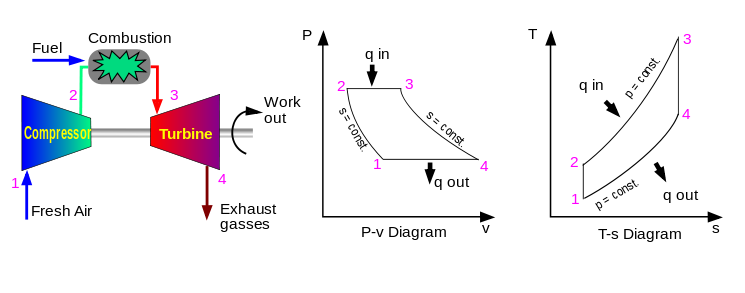

The efficiency of the HPC is a critical feature as it is directly related to the health index used to determine the remaining useful life of the engine. We assume adiabatic and reversible (also known as isentropic) processes. With this simplification we can estimate the efficieny using the temperatures at the inlet and outlet as per the equations below:

\begin{align}
\eta_{LPC} &= 1-\frac{T_2}{T_{24}} \\
\eta_{HPC} &= 1-\frac{T_{24}}{T_{30}} \\
\end{align}

In [ ]:
engine_feature_names = ['eLPC', 'eHPC', ]

eLPC = 1.0 - (engine_df['T2'] / engine_df['T24'])
eHPC = 1.0 - (engine_df['T24'] / engine_df['T30'])

engine_features = pd.concat([eLPC, eHPC], axis=1)
engine_features.columns = engine_feature_names
engine_features.head()

,eLPC,eHPC
0,0.191876,0.596263
1,0.192292,0.596594
2,0.192543,0.595495
3,0.192543,0.594166
4,0.192568,0.594169


##Dimension Reduction Features

These features are created to reduce the feature space of the problem.

The fan speed and demanded fan speed can be combined into an fan speed error feature, as show below. As the demanded fan speed is a constant value, the distribution of the fan speed error should be directly proportional to the distribution of the fan speed.

\begin{align}
N^f_{error} &= N^f - N^f_{dmd}
\end{align}

In [ ]:
reduction_feature_names = ['Nf_err']

Nf_err = np.abs(engine_df['Nf_dmd'] - engine_df['Nf'])

reduction_feature = pd.DataFrame({'Nf_err': Nf_err})
reduction_feature.head()

,Nf_err
0,0.06
1,0.04
2,0.08
3,0.11
4,0.06


We can now combine all of the new features with the sensor data.

In [ ]:
engine_df2 = pd.concat([engine_df, atm_features, engine_features, reduction_feature], axis = 1)
engine_df2.head()

,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL,Engine_Type,OP_Condition,rho2,v_sound,u2,mdot_2,eLPC,eHPC,Nf_err
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,192,191,1,1,0.025559,1116.424409,-0.446570,-0.011414,0.191876,0.596263,0.06
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,192,190,1,1,0.025559,1116.424409,-0.334927,-0.008560,0.192292,0.596594,0.04
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,192,189,1,1,0.025559,1116.424409,0.334927,0.008560,0.192543,0.595495,0.08
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,192,188,1,1,0.025559,1116.424409,0.000000,0.000000,0.192543,0.594166,0.11
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,192,187,1,1,0.025559,1116.424409,-0.223285,-0.005707,0.192568,0.594169,0.06


##Business Objective: Risk Assessment

A decision tree is used to group the engines into risk categories based on the remaining useful life (RUL) using the operational and sensor parameters. 

These risk categories can be used to prioitize engine maintenance and prepare for replacement before the QuAM predicts engine failure. They can also be used as an administrative tool to focus monitoring of high risk engines.

The proposed risk categories are High, Medium, and Low and the RUL thresholds are determine by observing the histogram of RUL values.

In [ ]:
print(engine_df2['RUL'].describe())
fig = px.histogram(engine_df2, x='RUL', color='OP_Condition')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=1, b=0))
fig.show()

count    160359.000000
mean        122.331338
std          83.538146
min           0.000000
25%          56.000000
50%         113.000000
75%         172.000000
max         542.000000
Name: RUL, dtype: float64


In [ ]:
risk_levels = {'High': 56.0, 'Medium': 83.0, 'Low': 172.0}

In [ ]:
DT_category_name = 'Risk_Level'
DT_label = 'RUL'
engine_df2[DT_category_name] = "Risk Needed"
RUL_Series = engine_df2[DT_label]

low_risk = (RUL_Series >= risk_levels['Low'])
med_risk = (RUL_Series >= risk_levels['High']) & (RUL_Series < risk_levels['Low'])
high_risk = (RUL_Series < risk_levels['High'])

engine_df2.loc[high_risk, DT_category_name] = 'High'
engine_df2.loc[med_risk, DT_category_name] = 'Medium'
engine_df2.loc[low_risk, DT_category_name] = 'Low'

In [ ]:
fig = px.histogram(engine_df2, x='RUL', color='Risk_Level')
fig.update_layout(height=300, margin=dict(l=0, r=0, t=1, b=0))
fig.show()

## Features to Consider to build the models

We can drop the following features as they are either constant values providing no usable information for the decision tree, irrelent to the categorizing process, or were used to created more useful features.

In [ ]:
engine_df2.columns

Index(['Unit_Number', 'Time_in_Cycles', 'OP Setting_1', 'OP Setting_2',
       'OP Setting_3', 'T2', 'T24', 'T30', 'T50', 'P2', 'P15', 'P30', 'Nf',
       'Nc', 'epr', 'Ps30', 'phi', 'NRf', 'NRc', 'BPR', 'farB', 'htBleed',
       'Nf_dmd', 'PCNfR_dmd', 'W31', 'W32', 'Time_to_Failure', 'RUL',
       'Engine_Type', 'OP_Condition', 'rho2', 'v_sound', 'u2', 'mdot_2',
       'eLPC', 'eHPC', 'Nf_err', 'Risk_Level'],
      dtype='object')

In [ ]:
dropped_features = ['Unit_Number', 'Time_in_Cycles', 'OP Setting_3',
                    'T2', 'P2', 'P15', 'phi', 'epr', 'farB',
                    'Nf_dmd', 'PCNfR_dmd', 'NRc', 'NRf', 'Engine_Type', 'OP_Condition',
                    'Time_to_Failure', 'rho2', 'v_sound', 'u2', 'htBleed' ,'RUL', 'Risk_Level']
 
DT_feature_names = engine_df2.columns.to_list()
for feature in dropped_features:
  DT_feature_names.remove(feature)

engine_df2[DT_feature_names].head()

,OP Setting_1,OP Setting_2,T24,T30,T50,P30,Nf,Nc,Ps30,BPR,W31,W32,mdot_2,eLPC,eHPC,Nf_err
0,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,8.4195,39.06,23.4190,-0.011414,0.191876,0.596263,0.06
1,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,8.4318,39.00,23.4236,-0.008560,0.192292,0.596594,0.04
2,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,8.4178,38.95,23.3442,0.008560,0.192543,0.595495,0.08
3,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,8.3682,38.88,23.3739,0.000000,0.192543,0.594166,0.11
4,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,8.4294,38.90,23.4044,-0.005707,0.192568,0.594169,0.06


In [ ]:
engine_df2[DT_feature_names].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160359 entries, 0 to 61248
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   OP Setting_1  160359 non-null  float64
 1   OP Setting_2  160359 non-null  float64
 2   T24           160359 non-null  float64
 3   T30           160359 non-null  float64
 4   T50           160359 non-null  float64
 5   P30           160359 non-null  float64
 6   Nf            160359 non-null  float64
 7   Nc            160359 non-null  float64
 8   Ps30          160359 non-null  float64
 9   BPR           160359 non-null  float64
 10  W31           160359 non-null  float64
 11  W32           160359 non-null  float64
 12  mdot_2        160359 non-null  float64
 13  eLPC          160359 non-null  float64
 14  eHPC          160359 non-null  float64
 15  Nf_err        160359 non-null  float64
dtypes: float64(16)
memory usage: 20.8 MB


We create a correlation matrix for the remaining features. 



In [ ]:
import seaborn as sns
from matplotlib import pyplot as plt

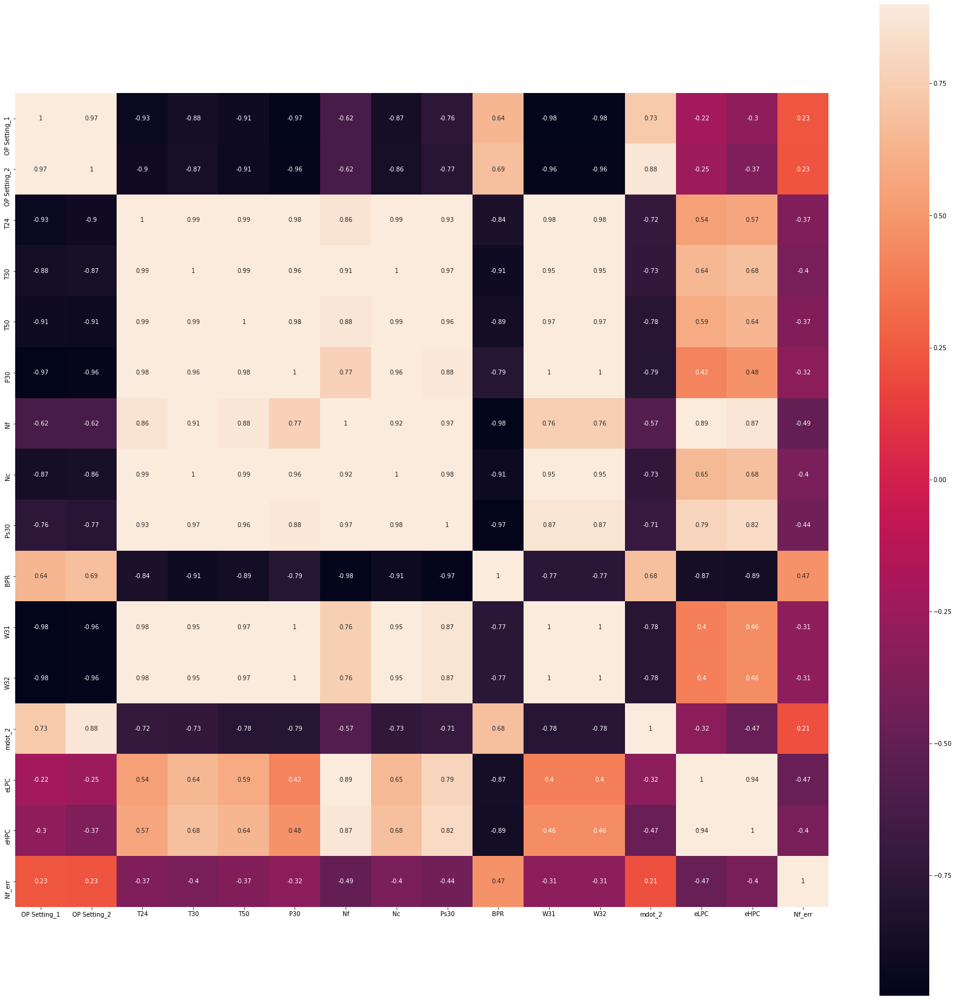

In [ ]:
corr_mat = engine_df2[DT_feature_names].corr()
plt.figure(figsize=(30,30))
ax=sns.heatmap(corr_mat, vmax = 0.9, square=True, annot=True)
plt.show()


# Visualizing New Features for Operating conditions 6 

In [ ]:
Engine_OP6 = pd.DataFrame(engine_df2.loc[(engine_df2.loc[:,'OP_Condition']==5),:])

# fig = px.histogram(Engine_OP6, x='eHPC', marginal="box")
# fig.update_layout(height=300, margin=dict(l=0, r=0, t=0, b=0))
# fig.show()

In [ ]:
Engine_OP6

,Unit_Number,Time_in_Cycles,OP Setting_1,OP Setting_2,OP Setting_3,T2,T24,T30,T50,P2,P15,P30,Nf,Nc,epr,Ps30,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,Time_to_Failure,RUL,Engine_Type,OP_Condition,rho2,v_sound,u2,mdot_2,eLPC,eHPC,Nf_err,Risk_Level
0,1,1,34.9983,0.8400,100.0,449.44,555.32,1358.61,1137.23,5.48,8.00,194.64,2222.65,8341.91,1.02,42.02,183.06,2387.72,8048.56,9.3461,0.02,334,2223,100.0,14.73,8.8071,149,148,2,5,0.010899,1039.24901,872.969168,9.514650,0.190665,0.591259,0.35,Medium
15,1,16,35.0053,0.8419,100.0,449.44,555.56,1362.41,1126.95,5.48,8.00,194.44,2222.76,8336.74,1.02,41.74,182.78,2387.76,8053.94,9.3232,0.02,332,2223,100.0,14.96,8.9446,149,133,2,5,0.010899,1039.24901,874.943741,9.536172,0.191014,0.592223,0.24,Medium
17,1,18,34.9996,0.8404,100.0,449.44,555.45,1365.15,1135.62,5.48,8.00,193.77,2222.70,8336.57,1.02,41.98,182.72,2387.72,8052.73,9.3419,0.02,334,2223,100.0,14.99,8.9676,149,131,2,5,0.010899,1039.24901,873.384868,9.519181,0.190854,0.593122,0.30,Medium
41,1,42,35.0029,0.8400,100.0,449.44,555.34,1365.14,1136.45,5.48,8.00,194.88,2222.69,8335.88,1.02,41.90,182.74,2387.72,8057.20,9.3769,0.02,334,2223,100.0,14.66,8.8740,149,107,2,5,0.010899,1039.24901,872.969168,9.514650,0.190694,0.593199,0.31,Medium
44,1,45,35.0033,0.8400,100.0,449.44,555.28,1370.22,1129.04,5.48,8.00,194.41,2222.66,8338.36,1.02,41.91,182.67,2387.74,8051.91,9.3577,0.02,334,2223,100.0,14.82,9.0246,149,104,2,5,0.010899,1039.24901,872.969168,9.514650,0.190607,0.594751,0.34,Medium
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61214,249,221,34.9981,0.8400,100.0,449.44,555.59,1360.27,1127.38,5.48,7.96,195.65,2223.28,8377.04,1.03,41.83,184.59,2388.38,8084.56,9.2077,0.02,336,2223,100.0,15.05,8.9608,255,34,4,5,0.010899,1039.24901,872.969168,9.514650,0.191058,0.591559,0.28,High
61217,249,224,35.0053,0.8400,100.0,449.44,555.50,1369.43,1131.90,5.48,7.97,196.53,2223.32,8373.31,1.03,42.13,185.09,2388.41,8091.87,9.1552,0.02,333,2223,100.0,15.00,8.9784,255,31,4,5,0.010899,1039.24901,872.969168,9.514650,0.190927,0.594357,0.32,High
61226,249,233,35.0042,0.8400,100.0,449.44,555.31,1367.81,1139.78,5.48,7.97,196.73,2223.40,8390.43,1.04,42.29,185.83,2388.53,8107.01,9.1695,0.02,336,2223,100.0,15.16,9.0471,255,22,4,5,0.010899,1039.24901,872.969168,9.514650,0.190650,0.594015,0.40,High
61236,249,243,35.0048,0.8400,100.0,449.44,555.96,1371.87,1146.58,5.48,7.97,198.66,2223.50,8401.93,1.04,42.39,186.80,2388.66,8109.66,9.1205,0.02,336,2223,100.0,14.88,9.0603,255,12,4,5,0.010899,1039.24901,872.969168,9.514650,0.191597,0.594743,0.50,High


In [ ]:
type(Engine_OP6)

pandas.core.frame.DataFrame

In [ ]:
dropped_features = ['Unit_Number', 'Time_in_Cycles', 'OP Setting_3',
                    'T2', 'P2', 'P15', 'phi', 'epr', 'farB',
                    'Nf_dmd', 'PCNfR_dmd', 'NRc', 'NRf', 'Engine_Type', 'OP_Condition',
                    'Time_to_Failure', 'rho2', 'v_sound', 'u2', 'htBleed' ,'RUL', 'Risk_Level']
 
Engine_OP6.drop(['Unit_Number', 'Time_in_Cycles', 'OP Setting_3',
                    'T2', 'P2', 'P15', 'phi', 'epr', 'farB',
                    'Nf_dmd', 'PCNfR_dmd', 'NRc', 'NRf', 'Engine_Type', 'OP_Condition',
                    'Time_to_Failure', 'rho2', 'v_sound', 'u2', 'htBleed' ,'RUL'], axis=1, inplace=True)
Engine_OP6.head()

,OP Setting_1,OP Setting_2,T24,T30,T50,P30,Nf,Nc,Ps30,BPR,W31,W32,mdot_2,eLPC,eHPC,Nf_err,Risk_Level
0,34.9983,0.8400,555.32,1358.61,1137.23,194.64,2222.65,8341.91,42.02,9.3461,14.73,8.8071,9.514650,0.190665,0.591259,0.35,Medium
15,35.0053,0.8419,555.56,1362.41,1126.95,194.44,2222.76,8336.74,41.74,9.3232,14.96,8.9446,9.536172,0.191014,0.592223,0.24,Medium
17,34.9996,0.8404,555.45,1365.15,1135.62,193.77,2222.70,8336.57,41.98,9.3419,14.99,8.9676,9.519181,0.190854,0.593122,0.30,Medium
41,35.0029,0.8400,555.34,1365.14,1136.45,194.88,2222.69,8335.88,41.90,9.3769,14.66,8.8740,9.514650,0.190694,0.593199,0.31,Medium
44,35.0033,0.8400,555.28,1370.22,1129.04,194.41,2222.66,8338.36,41.91,9.3577,14.82,9.0246,9.514650,0.190607,0.594751,0.34,Medium


##<font color='blue'> Split your data into testing and training.

## Train/Test Data Split

In [ ]:
Engine_OP6[DT_feature_names].values

array([[3.49983000e+01, 8.40000000e-01, 5.55320000e+02, ...,
        1.90664842e-01, 5.91258713e-01, 3.50000000e-01],
       [3.50053000e+01, 8.41900000e-01, 5.55560000e+02, ...,
        1.91014472e-01, 5.92222606e-01, 2.40000000e-01],
       [3.49996000e+01, 8.40400000e-01, 5.55450000e+02, ...,
        1.90854262e-01, 5.93121635e-01, 3.00000000e-01],
       ...,
       [3.50042000e+01, 8.40000000e-01, 5.55310000e+02, ...,
        1.90650267e-01, 5.94015251e-01, 4.00000000e-01],
       [3.50048000e+01, 8.40000000e-01, 5.55960000e+02, ...,
        1.91596518e-01, 5.94742942e-01, 5.00000000e-01],
       [3.50046000e+01, 8.40000000e-01, 5.55770000e+02, ...,
        1.91320150e-01, 5.97644231e-01, 7.80000000e-01]])

In [ ]:
Engine_OP6[DT_category_name].values


array(['Medium', 'Medium', 'Medium', ..., 'High', 'High', 'High'],
      dtype=object)

In [ ]:
from sklearn.preprocessing import LabelEncoder
y_preprocess = LabelEncoder()
X = Engine_OP6[DT_feature_names].values
y = y_preprocess.fit_transform(Engine_OP6[DT_category_name])

In [ ]:
display(X,y)

array([[3.49983000e+01, 8.40000000e-01, 5.55320000e+02, ...,
        1.90664842e-01, 5.91258713e-01, 3.50000000e-01],
       [3.50053000e+01, 8.41900000e-01, 5.55560000e+02, ...,
        1.91014472e-01, 5.92222606e-01, 2.40000000e-01],
       [3.49996000e+01, 8.40400000e-01, 5.55450000e+02, ...,
        1.90854262e-01, 5.93121635e-01, 3.00000000e-01],
       ...,
       [3.50042000e+01, 8.40000000e-01, 5.55310000e+02, ...,
        1.90650267e-01, 5.94015251e-01, 4.00000000e-01],
       [3.50048000e+01, 8.40000000e-01, 5.55960000e+02, ...,
        1.91596518e-01, 5.94742942e-01, 5.00000000e-01],
       [3.50046000e+01, 8.40000000e-01, 5.55770000e+02, ...,
        1.91320150e-01, 5.97644231e-01, 7.80000000e-01]])

array([2, 2, 2, ..., 0, 0, 0])

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=42)

In [ ]:
display(X_train,y_train)

array([[3.50030000e+01, 8.40300000e-01, 5.55190000e+02, ...,
        1.90475333e-01, 5.93246540e-01, 1.00000000e-01],
       [3.50037000e+01, 8.40000000e-01, 5.55920000e+02, ...,
        1.91538351e-01, 5.92332400e-01, 1.90000000e-01],
       [3.49987000e+01, 8.40000000e-01, 5.55780000e+02, ...,
        1.91334701e-01, 5.92751627e-01, 6.00000000e-02],
       ...,
       [3.50022000e+01, 8.40000000e-01, 5.55200000e+02, ...,
        1.90489914e-01, 5.94199509e-01, 1.00000000e-02],
       [3.50017000e+01, 8.40400000e-01, 5.55410000e+02, ...,
        1.90795989e-01, 5.92724313e-01, 2.00000000e-02],
       [3.50009000e+01, 8.40100000e-01, 5.55600000e+02, ...,
        1.91072714e-01, 5.93598221e-01, 1.20000000e-01]])

array([1, 2, 1, ..., 2, 0, 2])

##<font color ='blue'> Determine whether your label data needs to be discretized as we did with the Boston Housing dataset during L3-2.

Data needs to be discretized as we are classifying risk based on the remaining useful life (RUL) to maximize the operating lifetime of the engines.

#Decision Tree Model

## Exploring Decision Tree Construction

In [ ]:
from sklearn.tree import DecisionTreeClassifier, export_graphviz
import plotly.express as px
import graphviz
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, plot_confusion_matrix

In [ ]:
from sklearn.preprocessing import LabelEncoder
y_preprocess = LabelEncoder()

labels=list(y_preprocess.fit_transform(list(risk_levels.keys())))
labels


[0, 2, 1]

Below is helper function to evaluate a given Decision Tree based on precision, recall, and F1 score.

In [ ]:
def Evaluate_DT(DecisionTree, X_train, y_train, yhat_train, 
                X_test, y_test, yhat_test, Context, Show_CM = True):
  """
  Prints the context string and then calculates accuracy, precision, recall, 
  F1 score and plots the confusion matrix for a given Decision Tree.

  """
  print(Context)
  print("Accuracy on training data:", accuracy_score(y_train, yhat_train).round(4))
  print("Precision on training data:", precision_score(y_train, yhat_train, average=None).round(4))
  print("Recall on training data:", recall_score(y_train, yhat_train, average=None).round(4))
  print("F1 score on training data:", f1_score(y_train, yhat_train, average=None).round(4))
  if Show_CM == True:
    plot_confusion_matrix(DecisionTree, X_train, y_train, labels=labels)
  print("Accuracy on test data:", accuracy_score(y_test, yhat_test).round(4))
  print("Precision on test data:", precision_score(y_test, yhat_test, average=None).round(4))
  print("Recall on test data:", recall_score(y_test, yhat_test, average=None).round(4))
  print("F1 score on test data:", f1_score(y_test, yhat_test, average=None).round(4))
  if Show_CM == True:
    plot_confusion_matrix(DecisionTree, X_test, y_test, labels=labels)
  print('---------------------')

# <font color ='blue'> 1. Vary the criterion hyperparameter

--- Gini Criterion ---
Accuracy on training data: 1.0
Precision on training data: [1. 1. 1.]
Recall on training data: [1. 1. 1.]
F1 score on training data: [1. 1. 1.]
Accuracy on test data: 0.6267
Precision on test data: [0.7541 0.4588 0.6429]
Recall on test data: [0.779  0.4648 0.628 ]
F1 score on test data: [0.7664 0.4618 0.6353]
---------------------


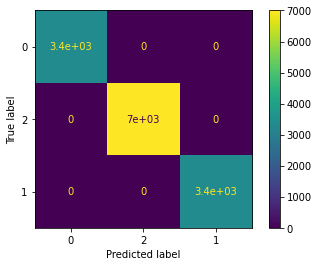

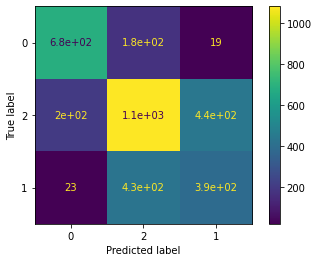

In [ ]:
context = "--- Gini Criterion ---"
DT_OP6 = DecisionTreeClassifier(criterion='gini')
DT_OP6.fit(X_train, y_train)
yhat_train = DT_OP6.predict(X_train)
yhat_test = DT_OP6.predict(X_test)
Evaluate_DT(DT_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

--- Entropy Criterion ---
Accuracy on training data: 1.0
Precision on training data: [1. 1. 1.]
Recall on training data: [1. 1. 1.]
F1 score on training data: [1. 1. 1.]
Accuracy on test data: 0.632
Precision on test data: [0.7742 0.4553 0.6447]
Recall on test data: [0.7847 0.4553 0.6402]
F1 score on test data: [0.7794 0.4553 0.6424]
---------------------


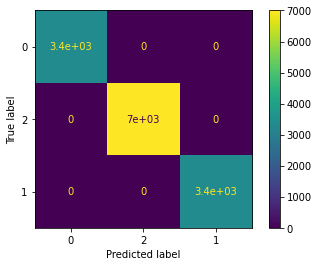

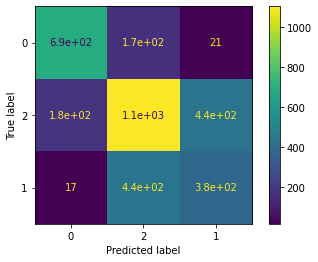

In [ ]:
context = "--- Entropy Criterion ---"
DT_OP6 = DecisionTreeClassifier(criterion='entropy')
DT_OP6.fit(X_train, y_train)
yhat_train = DT_OP6.predict(X_train)
yhat_test = DT_OP6.predict(X_test)
Evaluate_DT(DT_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

Varying the criterion had little impact on the performance of the decision trees since both overfitted the training data. The entropy criterion performed slightly better in this instance.

# <font color ='blue'> 2. Vary the splitter hyperparameter

--- Best Splitter ---
Accuracy on training data: 1.0
Precision on training data: [1. 1. 1.]
Recall on training data: [1. 1. 1.]
F1 score on training data: [1. 1. 1.]
Accuracy on test data: 0.6308
Precision on test data: [0.7572 0.4661 0.6434]
Recall on test data: [0.7813 0.4589 0.6378]
F1 score on test data: [0.7691 0.4625 0.6406]
---------------------


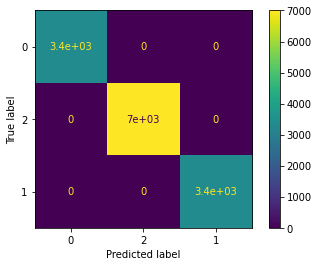

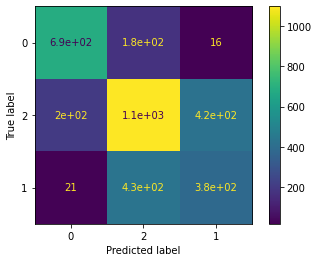

In [ ]:
context = "--- Best Splitter ---"
DT_OP6 = DecisionTreeClassifier(splitter= 'best')
DT_OP6.fit(X_train, y_train)
yhat_train = DT_OP6.predict(X_train)
yhat_test = DT_OP6.predict(X_test)
Evaluate_DT(DT_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

--- Random Splitter ---
Accuracy on training data: 1.0
Precision on training data: [1. 1. 1.]
Recall on training data: [1. 1. 1.]
F1 score on training data: [1. 1. 1.]
Accuracy on test data: 0.6265
Precision on test data: [0.7664 0.4557 0.6397]
Recall on test data: [0.7733 0.466  0.6297]
F1 score on test data: [0.7698 0.4608 0.6347]
---------------------


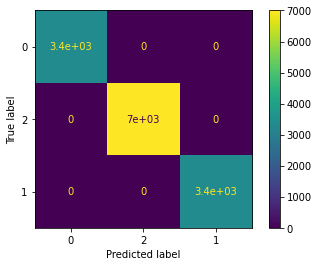

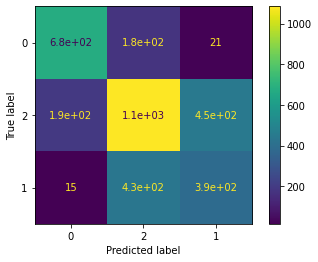

In [ ]:
context = "--- Random Splitter ---"
DT_OP6 = DecisionTreeClassifier(splitter= 'random')
DT_OP6.fit(X_train, y_train)
yhat_train = DT_OP6.predict(X_train)
yhat_test = DT_OP6.predict(X_test)
Evaluate_DT(DT_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

Varying the splitter option also did not have a significant impact of the performance of the decision tree. The F1 score was slightly better using the best option compared to the random option.

# <font color = 'blue'>3. Vary the min_samples_split hyperparameter

(a) Choose value 1 as your min_samples_split and report the accuracy, precision, recall
and F1-score.

Minimum sample split needs to be more than 1 to determine prediction.

(b) Choose value 2 as your min_samples_split and report the accuracy, precision, recall
and F1-score.

In [ ]:
sample_split_sizes = [2,5,10,20]
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []

for index, sample_size in enumerate(sample_split_sizes):
  DT_OP6 = DecisionTreeClassifier(min_samples_split = sample_size)
  DT_OP6.fit(X_train, y_train)
  yhat_train = DT_OP6.predict(X_train)
  yhat_test = DT_OP6.predict(X_test)

  accuracy_values.append(round(accuracy_score(y_test, yhat_test),4))
  precision_values.append(precision_score(y_test, yhat_test, average=None).round(4))
  recall_values.append(recall_score(y_test, yhat_test, average=None).round(4))
  f1_values.append(f1_score(y_test, yhat_test, average=None).round(4))

results_df = pd.DataFrame({
    'Accuracy': accuracy_values,
    'Precision' : precision_values,
    'Recall' : recall_values,
    'F1' : f1_values,
    'Split_Size': sample_split_sizes
})

results_df

,Accuracy,Precision,Recall,F1,Split_Size
0,0.6291,"[0.7553, 0.4685, 0.6407]","[0.7665, 0.4613, 0.6407]","[0.7609, 0.4649, 0.6407]",2
1,0.6279,"[0.7544, 0.4611, 0.6423]","[0.7802, 0.4589, 0.6326]","[0.7671, 0.46, 0.6374]",5
2,0.6305,"[0.7578, 0.4614, 0.6463]","[0.8052, 0.4708, 0.6193]","[0.7808, 0.4661, 0.6325]",10
3,0.6448,"[0.7754, 0.4759, 0.6584]","[0.8178, 0.4827, 0.6355]","[0.796, 0.4793, 0.6468]",20


# <font color = 'blue'> 4. Vary the min_samples_leaf hyperparameter

(a) Choose value 1 as your min_samples_leaf and report the accuracy, precision, recall
and F1-score.

In [ ]:
sample_leaf_sizes = [1,5,10,20]
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []

for index, leaf_size in enumerate(sample_leaf_sizes):
  DT_OP6 = DecisionTreeClassifier(min_samples_leaf= leaf_size)
  DT_OP6.fit(X_train, y_train)
  yhat_train = DT_OP6.predict(X_train)
  yhat_test = DT_OP6.predict(X_test)

  accuracy_values.append(round(accuracy_score(y_test, yhat_test),4))
  precision_values.append(precision_score(y_test, yhat_test, average=None).round(4))
  recall_values.append(recall_score(y_test, yhat_test, average=None).round(4))
  f1_values.append(f1_score(y_test, yhat_test, average=None).round(4))

results_df = pd.DataFrame({
    'Accuracy': accuracy_values,
    'Precision' : precision_values,
    'Recall' : recall_values,
    'F1' : f1_values,
       'Sample_Leaf_Size': [1,5,10,20]
})

results_df

,Accuracy,Precision,Recall,F1,Sample_Leaf_Size
0,0.6323,"[0.77, 0.4634, 0.6444]","[0.7779, 0.4672, 0.6384]","[0.7739, 0.4653, 0.6414]",1
1,0.6474,"[0.7911, 0.4789, 0.6575]","[0.7938, 0.4875, 0.6506]","[0.7925, 0.4832, 0.654]",5
2,0.6587,"[0.7843, 0.5012, 0.6674]","[0.8075, 0.4875, 0.6663]","[0.7957, 0.4943, 0.6669]",10
3,0.6846,"[0.8329, 0.5367, 0.6738]","[0.8121, 0.4625, 0.7278]","[0.8224, 0.4968, 0.6998]",20


(b) Choose value 2 as your min_samples_leaf and report the accuracy, precision, recall
and F1-score.

In [ ]:
sample_leaf_sizes = [2,5,10,20]
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []

for index, leaf_size in enumerate(sample_leaf_sizes):
  DT_OP6 = DecisionTreeClassifier(min_samples_leaf= leaf_size)
  DT_OP6.fit(X_train, y_train)
  yhat_train = DT_OP6.predict(X_train)
  yhat_test = DT_OP6.predict(X_test)

  accuracy_values.append(round(accuracy_score(y_test, yhat_test),4))
  precision_values.append(precision_score(y_test, yhat_test, average=None).round(4))
  recall_values.append(recall_score(y_test, yhat_test, average=None).round(4))
  f1_values.append(f1_score(y_test, yhat_test, average=None).round(4))

results_df = pd.DataFrame({
    'Accuracy': accuracy_values,
    'Precision' : precision_values,
    'Recall' : recall_values,
    'F1' : f1_values,
       'Sample_Leaf_Size': [2,5,10,20]
})

results_df

,Accuracy,Precision,Recall,F1,Sample_Leaf_Size
0,0.6314,"[0.7452, 0.4685, 0.6566]","[0.7995, 0.5054, 0.6071]","[0.7714, 0.4862, 0.6309]",2
1,0.6480,"[0.7912, 0.4793, 0.6573]","[0.7984, 0.4839, 0.6512]","[0.7948, 0.4816, 0.6542]",5
2,0.6602,"[0.7853, 0.5055, 0.668]","[0.8041, 0.4911, 0.6692]","[0.7946, 0.4982, 0.6686]",10
3,0.6831,"[0.8329, 0.5341, 0.6718]","[0.8121, 0.4577, 0.7272]","[0.8224, 0.4929, 0.6984]",20


# <font color='blue'> 5. Vary the max_depth hyperparameter:

(a) Assign a limiting depth, e.g. 4, for our hyperparameter and report the accuracy,
precision, recall and F1-score.

(b) Assign a 2nd limiting depth, e.g. 8, for our hyperparameter and report the accuracy,
precision, recall and F1-score.

In [ ]:
Tree_depths = [5,10,15,20]
accuracy_values = []
precision_values = []
recall_values = []
f1_values = []

for index, depth in enumerate(Tree_depths):
  DT_OP6 = DecisionTreeClassifier(max_depth= depth)
  DT_OP6.fit(X_train, y_train)
  yhat_train = DT_OP6.predict(X_train)
  yhat_test = DT_OP6.predict(X_test)

  accuracy_values.append(round(accuracy_score(y_test, yhat_test),4))
  precision_values.append(precision_score(y_test, yhat_test, average=None).round(4))
  recall_values.append(recall_score(y_test, yhat_test, average=None).round(4))
  f1_values.append(f1_score(y_test, yhat_test, average=None).round(4))

results_df = pd.DataFrame({
    'Accuracy': accuracy_values,
    'Precision' : precision_values,
    'Recall' : recall_values,
    'F1' : f1_values,
       'Max Depth': Tree_depths
})

results_df

,Accuracy,Precision,Recall,F1,Max Depth
0,0.7157,"[0.8662, 0.6574, 0.6728]","[0.7893, 0.3683, 0.8474]","[0.826, 0.4721, 0.7501]",5
1,0.7009,"[0.8459, 0.5924, 0.6752]","[0.7813, 0.4279, 0.7928]","[0.8123, 0.4969, 0.7293]",10
2,0.6640,"[0.8021, 0.5132, 0.6594]","[0.7711, 0.4386, 0.7191]","[0.7863, 0.473, 0.688]",15
3,0.6532,"[0.7823, 0.502, 0.6556]","[0.7733, 0.4601, 0.686]","[0.7778, 0.4801, 0.6704]",20


# <font color = 'blue'> 6. Hyperparameter Overview

The first four experiments (gini, enthropy, best, random) showed that the evaluation metrics between training and test data have big gap with training showing overfitting and having perfect split results and test data showing results around 46%-78% regardless of the evaluation method.

Accuracy, Precision, Recall and F1 Score for high risk_level under each criterion (Gini & Entropy) and splitter (Best & Random) show marginal variations. 


Training splits data shows overfitting results as a result of perfect correlated. By dropping some features (T24, T30, Opsetting2, Ps30, BPR and Nf)
we observed reduced accuracy and precision under both criterion and splitter. This indicates that these features have influence on the predicted results. 

Best accuracy is observed at sample_split and sample_leaf size 20, however, best results are obtained at max_depth size of 15.

##**<font color='blue'>Final Decision Tree & Evaluation**

<font color = 'blue'> 1. Which feature was used for the first split?  

Ps30

<font color = 'blue'> 2. How many leaves are in the optimal classifier/QuAM?

In [ ]:
print (leaf_size)

20


## Optimal Decision Tree

<font color='blue'>3. Produce a confusion_matrix and describe your QuAM’s accuracy in terms of the
number of true and false positives and negatives.



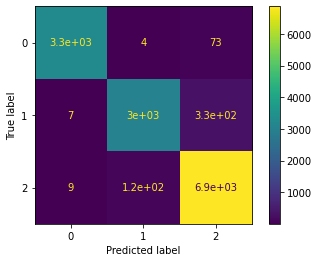

In [ ]:
from sklearn.metrics import plot_confusion_matrix



plot_confusion_matrix(DT_OP6, X_train, y_train)


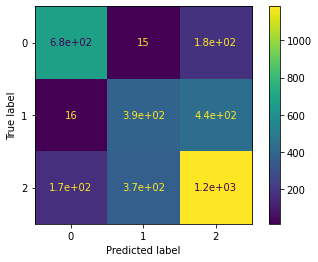

In [ ]:
plot_confusion_matrix(DT_OP6, X_test, y_test)

<font color='blue'>4. Using scikit-learn’s classification_report method, generate the accuracy,
precision, recall, and f1-score for your model and describe your QuAM’s accuracy.

In [ ]:
from sklearn.metrics import classification_report
from sklearn.tree import plot_tree

              precision    recall  f1-score   support

        High       0.79      0.80      0.80       878
      Medium       0.53      0.45      0.49       839
         Low       0.67      0.71      0.69      1723

    accuracy                           0.67      3440
   macro avg       0.66      0.65      0.66      3440
weighted avg       0.66      0.67      0.67      3440



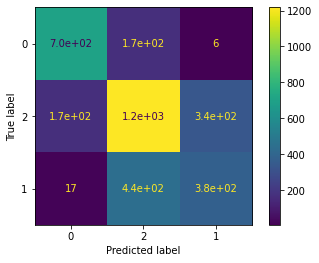

In [ ]:
context = "--- Optimal Tree ---"
DT_OP6 = DecisionTreeClassifier(criterion='gini',
                                   splitter= 'best',
                                   max_depth = 15, 
                                   min_samples_split = 10,
                                   min_samples_leaf = 10)
DT_OP6.fit(X_train, y_train)
yhat_train = DT_OP6.predict(X_train)
yhat_test = DT_OP6.predict(X_test)
print(classification_report(y_test, yhat_test, target_names=risk_levels.keys()))
plot_confusion_matrix(DT_OP6, X_test, y_test, labels=labels)

Looking at Precision, Recall and F1 Score it is shown that high risk level classified better as all of the evaluations are over 79%.  We divided our data into Low, Medium, High  based on 6 different conditions. It is possible that another method to divide data might produce higher QuAM results.

Accuracy score it is shown it is 70%. This is probably due to not enough info was given to measure health index. 

##<font color='blue'>**Visualize the structure of your final QuAM:**

<font color='blue'> 5. Plot your tree. [Hint: using scikit-learn’s tree.plot_tree ]

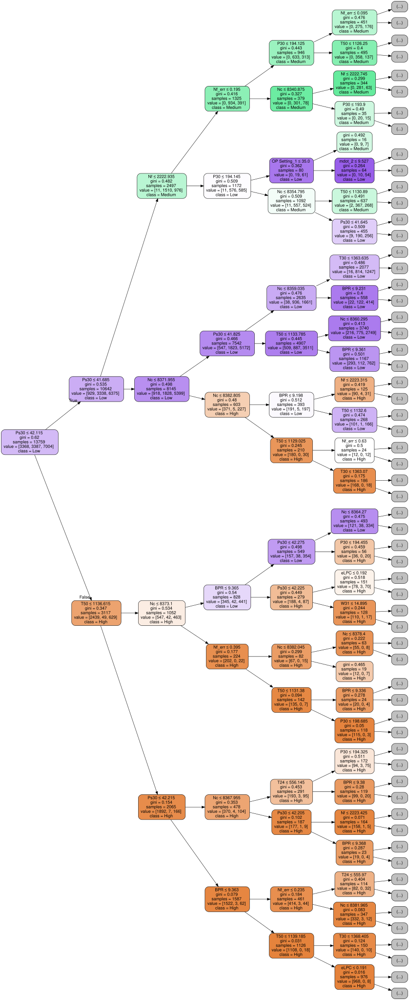

In [ ]:
tree_data = export_graphviz(DT_OP6,
                           out_file=None, 
                           class_names=list(risk_levels.keys()),
                           feature_names=DT_feature_names,  
                           filled=True,
                           rounded=True,  
                           special_characters=True,
                           rotate=True,
                          max_depth=5)  
graphviz.Source(tree_data)

In [ ]:
import sklearn
import matplotlib.pyplot as plt

plt.figure(figsize=(50,20), dpi=300)
sklearn.tree.plot_tree(DT_OP6, filled=True)
plt.show()

<font color='blue'> 6. Plot the decision surface of your tree using paired features.

Decision surface of the tree using paired features with Matplotlib:

In [ ]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

In [ ]:
Engine_OP6[DT_feature_names].head()

,OP Setting_1,OP Setting_2,T24,T30,T50,P30,Nf,Nc,Ps30,BPR,W31,W32,mdot_2,eLPC,eHPC,Nf_err
0,34.9983,0.8400,555.32,1358.61,1137.23,194.64,2222.65,8341.91,42.02,9.3461,14.73,8.8071,9.514650,0.190665,0.591259,0.35
15,35.0053,0.8419,555.56,1362.41,1126.95,194.44,2222.76,8336.74,41.74,9.3232,14.96,8.9446,9.536172,0.191014,0.592223,0.24
17,34.9996,0.8404,555.45,1365.15,1135.62,193.77,2222.70,8336.57,41.98,9.3419,14.99,8.9676,9.519181,0.190854,0.593122,0.30
41,35.0029,0.8400,555.34,1365.14,1136.45,194.88,2222.69,8335.88,41.90,9.3769,14.66,8.8740,9.514650,0.190694,0.593199,0.31
44,35.0033,0.8400,555.28,1370.22,1129.04,194.41,2222.66,8338.36,41.91,9.3577,14.82,9.0246,9.514650,0.190607,0.594751,0.34


In [ ]:
features_names=Engine_OP6[DT_feature_names].columns
features_names

Index(['OP Setting_1', 'OP Setting_2', 'T24', 'T30', 'T50', 'P30', 'Nf', 'Nc',
       'Ps30', 'BPR', 'W31', 'W32', 'mdot_2', 'eLPC', 'eHPC', 'Nf_err'],
      dtype='object')

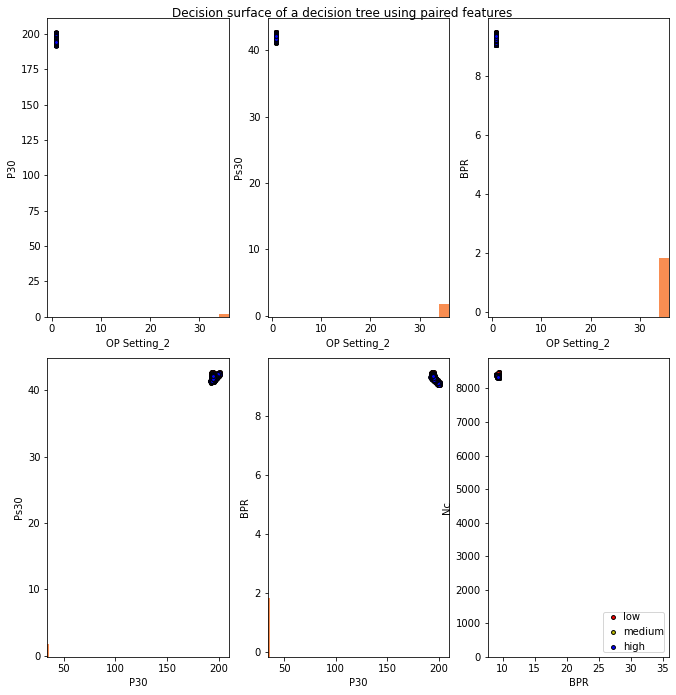

In [ ]:
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree
#fig, ax = plt.subplots(figsize=(10, 10))
plt.figure(figsize=(10,10))
# Parameters
n_classes = 3
plot_colors = "ryb"
plot_step = 0.02
y_train_code = le.fit_transform(y_train)
target_names =['low', 'medium', 'high']
# Load data
for pairidx, pair in enumerate([[1, 5], [1, 8], [1, 9],
                                [5, 8], [5, 9], [9, 7]
                                ]):
    # We only take the two corresponding features
    X = X_train[:, pair]
    y = y_train_code


    # Train
    clf = DecisionTreeClassifier(max_depth = 8,random_state = 42).fit(X, y)

    # Plot the decision boundary
    plt.subplot(2, 3, pairidx + 1)

    x_min, x_max = X_train[:, 0].min() - 1, X_train[:, 0].max() + 1
    y_min, y_max = X_train[:, 1].min() - 1, X_train[:, 1].max() + 1

    xx, yy = np.meshgrid(np.arange(x_min, x_max, plot_step),
                         np.arange(y_min, y_max, plot_step))
    plt.tight_layout(h_pad=0.5, w_pad=0.5, pad=2.5)

    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    cs = plt.contourf(xx, yy, Z, cmap=plt.cm.RdYlBu)

    plt.xlabel(features_names[pair[0]])
    plt.ylabel(features_names[pair[1]])

    # Plot the training points
    for i, color in zip(range(n_classes), plot_colors):
        idx = np.where(y == i)
        plt.scatter(X[idx, 0], X[idx, 1], c=color, label=target_names[i],
                    cmap=plt.cm.RdYlBu, edgecolor='black', s=15)

plt.suptitle("Decision surface of a decision tree using paired features")
plt.legend(loc='lower right', borderpad=0, handletextpad=0)
#plt.axis("tight")

#plt.figure(figsize=(10, 10))
#plt.show()

## <font color='blue'> **Decision tree path:**

<font color='blue'> 7. Provide a description of the potential path along your tree that a given new data point
might take and provide its final result. The idea being that we want to know what decisions
would be made along the way for that data point to end up at a particular label.

For more informative kind of visualization, showing us the distributuion of points in different regions in the tree, we need a package [dtreeviz](https://github.com/parrt/dtreeviz) that is not included in Colab environment by default, so we install it:

In [ ]:
!pip install dtreeviz

     |████████████████████████████████| 51kB 4.9MB/s 
     |████████████████████████████████| 204.2MB 70kB/s 
     |████████████████████████████████| 204kB 48.0MB/s 
  Created wheel for dtreeviz: filename=dtreeviz-1.1.3-cp36-none-any.whl size=52494 sha256=e0174dc6832926877892dca73c21a1dedc2ae78902c914838b88986b459f9514
  Stored in directory: /root/.cache/pip/wheels/80/a9/1e/4751fda06e88399ee09410646e9d55c88787276f9537b8ebd0
  Created wheel for pyspark: filename=pyspark-3.0.1-py2.py3-none-any.whl size=204612243 sha256=792c2f3cc2ccfd2c2c3426f094582f51b32be9ad9b060357fd8fc7e5d29bdac8
  Stored in directory: /root/.cache/pip/wheels/5e/bd/07/031766ca628adec8435bb40f0bd83bb676ce65ff4007f8e73f
Successfully built dtreeviz pyspark


Now, we use the dtreeviz object in the trees submodule of dtreeviz to create the visualization:

In [ ]:
from dtreeviz.trees import dtreeviz
from sklearn.preprocessing import LabelEncoder
import numpy as np

In [ ]:
y_preprocess = LabelEncoder()

X_tree = np.array(Engine_OP6[DT_feature_names].values)
y_tree = y_preprocess.fit_transform(Engine_OP6[DT_category_name].values)

class_names = y_preprocess.inverse_transform(np.arange(y_tree.max() + 1))

display(X_tree,y_tree)
class_names

array([[3.49983000e+01, 8.40000000e-01, 5.55320000e+02, ...,
        1.90664842e-01, 5.91258713e-01, 3.50000000e-01],
       [3.50053000e+01, 8.41900000e-01, 5.55560000e+02, ...,
        1.91014472e-01, 5.92222606e-01, 2.40000000e-01],
       [3.49996000e+01, 8.40400000e-01, 5.55450000e+02, ...,
        1.90854262e-01, 5.93121635e-01, 3.00000000e-01],
       ...,
       [3.50042000e+01, 8.40000000e-01, 5.55310000e+02, ...,
        1.90650267e-01, 5.94015251e-01, 4.00000000e-01],
       [3.50048000e+01, 8.40000000e-01, 5.55960000e+02, ...,
        1.91596518e-01, 5.94742942e-01, 5.00000000e-01],
       [3.50046000e+01, 8.40000000e-01, 5.55770000e+02, ...,
        1.91320150e-01, 5.97644231e-01, 7.80000000e-01]])

array([2, 2, 2, ..., 0, 0, 0])

array(['High', 'Low', 'Medium'], dtype=object)

In [ ]:
label_name='Risk_Level'

Sometimes, it is important to understand which decision path is followed by a specific test observation. The prediction path is usually used for interpretetion of a prediction to understand why the tree made xyz prediction for the observation abc.

Now, we can also visualize what happens when we want to make a prediction for a new data point:

In [ ]:

# pick random X observation for demo
X = X_train[np.random.randint(0, len(X_train)),:]

viz = dtreeviz(tree_model=DT_OP6,
               x_data=X_train,
               y_data=y_tree,
               target_name=label_name,
               feature_names=np.array(features_names),
               class_names=class_names.tolist(),
               orientation ='LR',
               X=X,  # pass the new data point
               scale=2.0
               )  
display(viz)

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


New data point: X
Prediction: Medium

Ps30 41.75

Nc 8336.00

T30 1358.10

T50 1123.29

eHPC 0.59

T50 1123.29

P30 195.02

BPR 9.32

Nf 2222.82

Nf_err 0.18
 

We use the explain_prediction_path function in the trees submodule of dtreeviz to generate an explanation of the prediction generated by the decision tree:

In [ ]:
from dtreeviz.trees import explain_prediction_path

In [ ]:
print(explain_prediction_path(tree_model=DT_OP6,
                              x=X,
                              feature_names=np.array(features_names),
                              explanation_type="plain_english"))

T30 < 1367.99
1118.79 <= T50  < 1126.25
194.12 <= P30 
Nf < 2222.93
Nc < 8343.44
Ps30 < 41.67
9.27 <= BPR  < 9.32
W32 < 9.02
mdot_2 < 9.52
Nf_err < 0.2



We can also see how important the different features were in predicting what the QuAM did:

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


AxesSubplot(0.125,0.125;0.775x0.755)


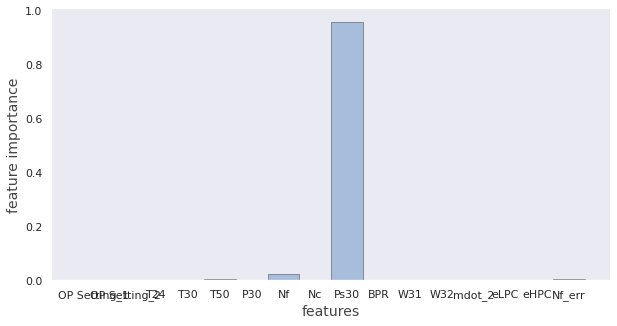

In [ ]:
print(explain_prediction_path(tree_model=DT_OP6,
                              x=X,
                              feature_names=np.array(features_names),
                              explanation_type="sklearn_default"))

In [ ]:
yhat_train = DT_OP6.predict(X_train)

array([[2944,   19,  405],
       [  43, 2178, 1166],
       [ 341,  683, 5980]])

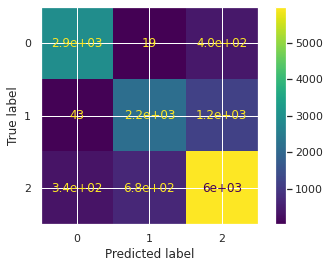

In [ ]:
cm = confusion_matrix(y_train, yhat_train)
display(cm)

plot_confusion_matrix(DT_OP6, X_train, y_train)

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print("Accuracy on training data:", accuracy_score(y_train, yhat_train))

print("Precision on training data:", precision_score(y_train, yhat_train, average=None))

print("Recall on training data:", recall_score(y_train, yhat_train, average=None))

print("F1 score on training data:", f1_score(y_train, yhat_train, average=None))

Accuracy on training data: 0.8068900356130533
Precision on training data: [0.88461538 0.75625    0.79194809]
Recall on training data: [0.87410926 0.64304694 0.85379783]
F1 score on training data: [0.87933094 0.69506941 0.82171075]


array([[ 705,    6,  167],
       [  17,  380,  442],
       [ 169,  336, 1218]])

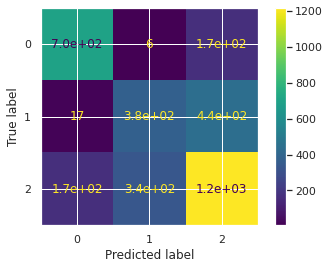

In [ ]:
yhat_test = DT_OP6.predict(X_test)

cm_test = confusion_matrix(y_test, yhat_test)
display(cm_test)

plot_confusion_matrix(DT_OP6, X_test, y_test)

In [ ]:
print("Accuracy on test data:", accuracy_score(y_test, yhat_test))

print("Precision on test data:", precision_score(y_test, yhat_test, average=None))

print("Recall on test data:", recall_score(y_test, yhat_test, average=None))

print("F1 score on test data:", f1_score(y_test, yhat_test, average=None))

Accuracy on test data: 0.6694767441860465
Precision on test data: [0.79124579 0.52631579 0.66666667]
Recall on test data: [0.80296128 0.45292014 0.70690656]
F1 score on test data: [0.79706049 0.48686739 0.68619718]


**<font color='blue'> Final Results of Test Data**

Comparing the results of training and test data sets - Accuracy and Precision reduced by 5%, Recall decreased by 4% and F1 Score also reduced by 5%.

## <font color = 'blue'> **Business Evaluation of Risk Evaluation**
<font color ='blue'>
1. What might be the motivation for a decision tree classifier?<br>

<font color ='black'>
The motivation behind a decision tree classifier would be to group a data set into meaningful distinct classes based on the distribution of the data.<br><br>
<font color ='blue'>
2. What is the “action” that should be taken given the results of this prediction?<br>
<font color ='black'>
The action that should be taken after the engine is given a risk level classification is to optimize the maintenance schedule of the engine and plan for replacement. This would concentrate maintenance resources on the higher risk engines and streamline the replacement process of components or entire engines.<br><br>
<font color ='blue'>
3. Who is the best immediate person(s) to make use of the results of your prediction?<br>
<font color ='black'>
The best immediate person to make use of these results is the the maintenance planner of the aircraft engine. This risk assessment is an early warning system based on onboard sensor data and is trained not to predict sudden failures, but slow wear over time. This will provide sufficient time for planners to prepare.<br><br>
<font color ='blue'>
4. What is the potential payoff of this prediction for an organization? (e.g. costs or efficiency).<br>
<font color ='black'>
The potential payoff of this prediction is significant cost savings in streamlining maintenance resources and maximizing usable life of these engines.<br><br>
<font color ='blue'>
5. Do your QuAMs results change your problem? If so, how and why? If not, please explain.<br>
<font color ='black'>
The results of this decision tree do not change our problem, but supplements the QuAM question of "Should this engine be replaced?" by providing more context to the health of the engine. This context is provided by sensor information other than the calculated RUL to determine the health of the engine.

##<font color='blue'> ***End of PA2***

##<font color='blue'> ***Begin of PA3***

#Feature Scaling

##<font color ='blue'> 1. Check Extreme Values:


<font color ='blue'>
a. Define what an extreme value is for each feature, e.g. using boxplots.<br><br>

<font color ='blue'>
b. Do any of your features contain extreme values? List the features & the number of
extreme values for each feature.<br><br>

<font color ='blue'>
c. Do the number of extreme values make-up a substantial portion of that feature?
(e.g. 5%) Or are they so few that you could consider dropping those samples?
Explain.

In [ ]:
features_names

Index(['OP Setting_1', 'OP Setting_2', 'T24', 'T30', 'T50', 'P30', 'Nf', 'Nc',
       'Ps30', 'BPR', 'W31', 'W32', 'mdot_2', 'eLPC', 'eHPC', 'Nf_err'],
      dtype='object')

In [ ]:
import seaborn as sns

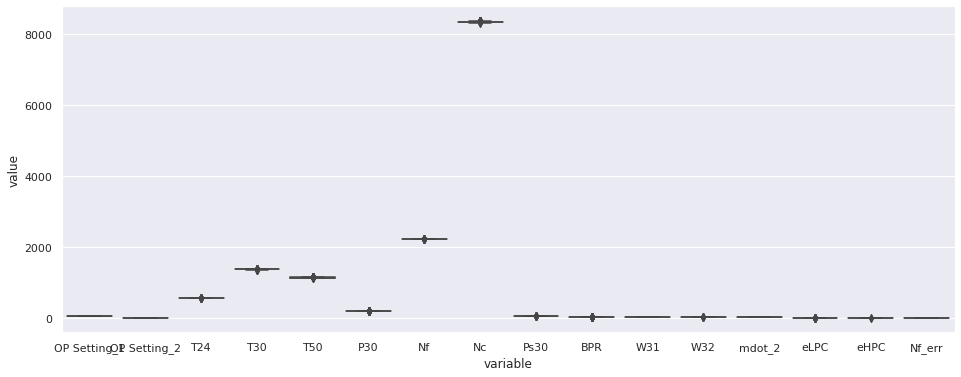

In [ ]:
sns.set()

plt.figure(figsize=(16, 6))
sns.boxplot(x="variable", y="value", data=pd.melt(Engine_OP6[DT_feature_names]))
plt.show()

As per the seaborn box plot for Engine_OP6 and the above Outliers table we generated for Operation Condition:6, it shows that we do  have outliers for the features that are in Engine_OP6 dataframe.

Let's try to plot the outliers with plotly boxplots for Engine_OP6 features. There are 16features in Engine_OP6 dataset. 

In [ ]:
for feature in features_names:
  fig = px.box(Engine_OP6, y=feature, color=label_name)
  fig.update_layout(height=300, margin=dict(l=0, r=0, t=0, b=0))
  fig.show()

The above box plots show the univariate distribution of each of the kNN features. Extreme values would show as distinct points on the top or bottom of the distribution, spaced away from the rest of the data.<br>
None of the features show extreme values that would raise concerns so no need to drop any features.

https://www.itl.nist.gov/div898/handbook/prc/section1/prc16.htm
As per the above online engineering statistics handbook 
The definition of extreme value or outlier : 
A point beyond an outer fence is considered an extreme value or outlier.

lower outer fence: 
$
\mathbf{Q_1} - \mathbf{3IQR}
$

upper outer fence: $\mathbf{Q_3} + \mathbf{3IQR}$

upperlimit or upper fence, interquartile range and lowerlimit or lowerfence are:

$\mathbf{Q_3} + \mathbf{1.5IQR}  $

$\mathbf{IQR} = \mathbf{Q_3} - \mathbf{Q_1} $

$\mathbf{Q_1} - \mathbf{1.5IQR}$


In [ ]:
def Remove_Extreme_Values(original_dataframe):

  dataframe = original_dataframe.copy()
  orig_data = dataframe.shape[0]
    
  for col in dataframe.columns:
    if dataframe.loc[:, col].dtypes == 'float64':
      Q3 = dataframe.loc[:,col].quantile(.75)
      Q1 = dataframe.loc[:,col].quantile(.25)
      IQR = Q3 - Q1
      upper_limit = Q3 + 1.5*IQR
      lower_limit = Q1 - 1.5*IQR

      extreme_values = (dataframe.loc[:,col] < lower_limit) | (dataframe.loc[:,col] > upper_limit)
      
      if extreme_values.any(): #Check if there is any rows outside of the limits
        counts = extreme_values.value_counts().to_list()[1] #Count the number of True values
        print(f'{counts} extreme values in {col}, ({100*counts/orig_data:.2f}% of the feature data).')
        extreme_values_indices = dataframe[extreme_values].index #Get indicies of all True values      
        dataframe.drop(index = extreme_values_indices, inplace = True)        
      else:
        print(f'No extreme values in {col}.')
  
  print(f'{100*(1 - dataframe.shape[0] / orig_data):.1f}% of the data was dropped.')
  return dataframe

In [ ]:
Engine_OP6 = Remove_Extreme_Values(Engine_OP6)

No extreme values in OP Setting_1.
No extreme values in OP Setting_2.
17 extreme values in T24, (0.13% of the feature data).
23 extreme values in T30, (0.17% of the feature data).
49 extreme values in T50, (0.37% of the feature data).
192 extreme values in P30, (1.44% of the feature data).
20 extreme values in Nf, (0.15% of the feature data).
56 extreme values in Nc, (0.42% of the feature data).
11 extreme values in Ps30, (0.08% of the feature data).
52 extreme values in BPR, (0.39% of the feature data).
No extreme values in W31.
9 extreme values in W32, (0.07% of the feature data).
No extreme values in mdot_2.
12 extreme values in eLPC, (0.09% of the feature data).
7 extreme values in eHPC, (0.05% of the feature data).
124 extreme values in Nf_err, (0.93% of the feature data).
4.8% of the data was dropped.


<font color ='blue'>2. Normalize your data and store this in a variable name that indicates that you’ve normalized
the data, e.g. X_train_norm.

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
min_max_scaler = MinMaxScaler()
D_Engine_OP6_minmax = min_max_scaler.fit_transform(Engine_OP6[DT_feature_names])
Engine_OP6_minmax= pd.DataFrame(D_Engine_OP6_minmax, columns=features_names)
Engine_OP6_minmax.head()

,OP Setting_1,OP Setting_2,T24,T30,T50,P30,Nf,Nc,Ps30,BPR,W31,W32,mdot_2,eLPC,eHPC,Nf_err
0,0.73,0.95,0.476190,0.426758,0.470083,0.474227,0.125000,0.204441,0.375000,0.540658,0.677966,0.589779,0.95,0.477228,0.428321,0.75000
1,0.16,0.20,0.428571,0.520755,0.688967,0.243986,0.031250,0.200880,0.575000,0.631171,0.728814,0.654007,0.20,0.429590,0.541297,0.93750
2,0.49,0.00,0.380952,0.520412,0.709922,0.625430,0.015625,0.186426,0.508333,0.800581,0.169492,0.392628,0.00,0.381933,0.551048,0.96875
3,0.79,0.05,0.186147,0.669297,0.470336,0.721649,0.031250,0.171554,0.533333,0.518393,0.491525,0.726054,0.05,0.186778,0.754346,0.93750
4,0.72,0.30,0.541126,0.315609,0.546832,0.247423,0.078125,0.283201,0.758333,0.562439,0.338983,0.412734,0.30,0.542158,0.292298,0.84375


<font color ='blue'>3. Standardize your data and store it in a variable name that indicates that you’ve normalized
the data, e.g. X_train_test.

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
standard_scaler = StandardScaler()
D_Engine_OP6_standard = standard_scaler.fit_transform(Engine_OP6[DT_feature_names])
Engine_OP6_standard= pd.DataFrame(D_Engine_OP6_standard, columns=features_names)
Engine_OP6_standard.head()

,OP Setting_1,OP Setting_2,T24,T30,T50,P30,Nf,Nc,Ps30,BPR,W31,W32,mdot_2,eLPC,eHPC,Nf_err
0,0.778445,2.145942,-0.119337,-0.402314,-0.170683,-0.141524,-1.586912,-1.655711,-0.610101,0.242586,0.963387,0.498971,2.145942,-0.118599,-0.406618,1.661053
1,-1.200999,-0.164716,-0.381914,0.118112,1.067281,-1.386711,-2.043875,-1.675563,0.491883,0.725773,1.239580,0.855192,-0.164716,-0.381288,0.212091,2.428429
2,-0.055005,-0.780891,-0.644492,0.116212,1.185794,0.676210,-2.120036,-1.756137,0.124555,1.630134,-1.798538,-0.594472,-0.780891,-0.644081,0.265493,2.556326
3,0.986807,-0.626848,-1.718674,0.940536,-0.169255,1.196587,-2.043875,-1.839047,0.262303,0.123727,-0.049319,1.254778,-0.626848,-1.720228,1.378842,2.428429
4,0.743717,0.143372,0.238724,-1.017707,0.263390,-1.368126,-1.815393,-1.216639,1.502035,0.358861,-0.877896,-0.482960,0.143372,0.239446,-1.151538,2.044741


<font color ='blue'>4. Visual & Numeric Comparison 1: Choose 3 features, and compare their standard
deviations of after standardizing & normalizing. What is the difference between these two
approaches on how your features are distributed [Hint: look at the mean].
a. Students take-away: data are more concentrated around the mean if we scale data
using Max-Min Normalization.

Choosing 3 features for comparision after normalization and standardization: T50, Nf, eHPC

In [ ]:
#standard deviation for T50 feature after normalizing using minmaxscaler
Engine_OP6_minmax_T50_std=Engine_OP6_minmax['T50'].std()
#standard deviation for T50 feature after standardizing using standardscaler
Engine_OP6_standard_T50_std=Engine_OP6_standard['T50'].std()
print("Engine_OP6_minmax_T50_std = ", Engine_OP6_minmax_T50_std)
print("Engine_OP6_standard_T50_std =", Engine_OP6_standard_T50_std)

Engine_OP6_minmax_T50_std =  0.1768167905593354
Engine_OP6_standard_T50_std = 1.0000392765264057


In [ ]:
#standard deviation for Nf feature after normalizing using minmaxscaler
Engine_OP6_minmax_Nf_std=Engine_OP6_minmax['Nf'].std()
#standard deviation for Nf feature after standardizing using standardscaler
Engine_OP6_standard_Nf_std=Engine_OP6_standard['Nf'].std()
print("Engine_OP6_minmax_Nf_std = ", Engine_OP6_minmax_Nf_std)
print("Engine_OP6_standard_Nf_std =", Engine_OP6_standard_Nf_std)

Engine_OP6_minmax_Nf_std =  0.20516660985955903
Engine_OP6_standard_Nf_std = 1.000039276526389


In [ ]:
#standard deviation for eHPC feature after normalizing using minmaxscaler
Engine_OP6_minmax_eHPC_std=Engine_OP6_minmax['eHPC'].std()
#standard deviation for eHPC feature after standardizing using standardscaler
Engine_OP6_standard_eHPC_std=Engine_OP6_standard['eHPC'].std()
print("Engine_OP6_minmax_eHPC_std = ", Engine_OP6_minmax_eHPC_std)
print("Engine_OP6_standard_eHPC_std =", Engine_OP6_standard_eHPC_std)

Engine_OP6_minmax_eHPC_std =  0.1826069859358974
Engine_OP6_standard_eHPC_std = 1.0000392765264001


<font color ='blue'>5. Visual & Numeric Comparison 2: Generate a boxplot for all three datasets, the original, the
normalized, and the standardized dataset. We expect to see a comparison like the one in
lab 5-2, where each box-n-whiskers plot corresponds to a different feature.

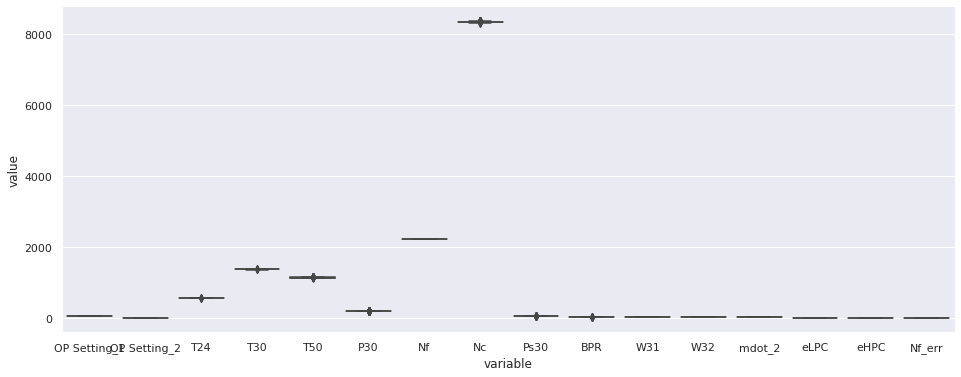

In [ ]:
#Generate a boxplot for the original dataset: Engine_OP6
plt.figure(figsize=(16, 6))
sns.boxplot(x="variable", y="value", data=pd.melt(Engine_OP6[DT_feature_names]))
plt.show()

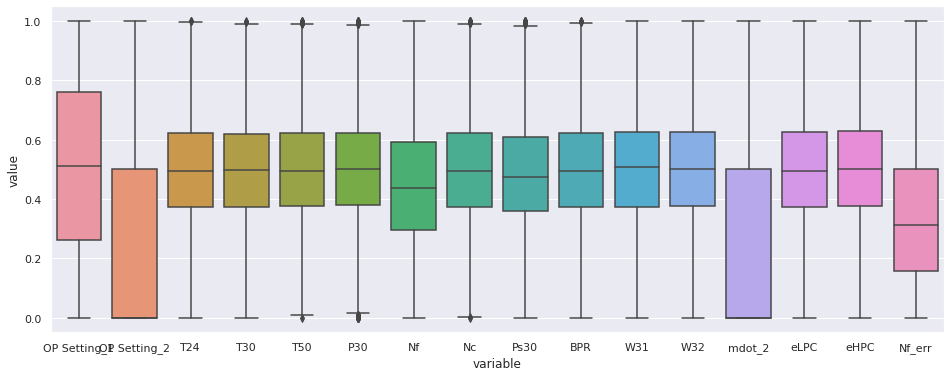

In [ ]:
#Generate a boxplot for the normalized dataset: Engine_OP6_minmax
plt.figure(figsize=(16, 6))
sns.boxplot(x="variable", y="value", data=pd.melt(Engine_OP6_minmax))
plt.show()

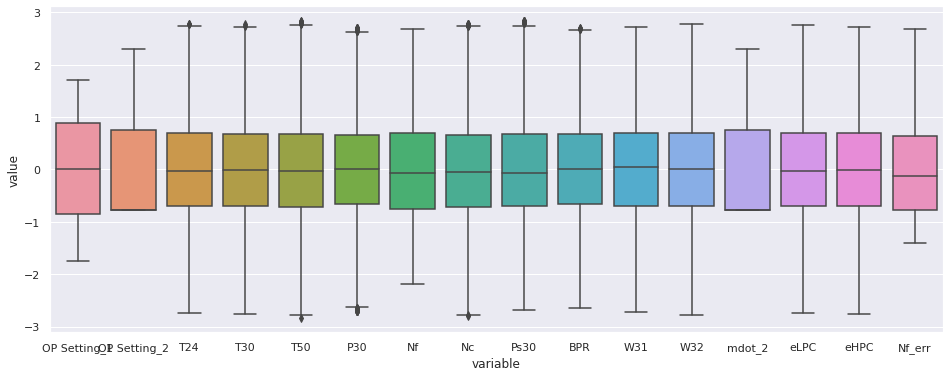

In [ ]:
#Generate a boxplot for the standardized dataset: Engine_OP6_standard
plt.figure(figsize=(16, 6))
sns.boxplot(x="variable", y="value", data=pd.melt(Engine_OP6_standard))
plt.show()

Note: The choice to normalize or standardize will depend on outliers: if you have several
features with many outliers, it's likely better for you to standardize. If not, it may be good for you to
normalize. We’ll compare the results of these choices when we build our QuAMs.

#Exploring kNN Construction:


<font color ='blue'>
1. Vary the n_neighbors parameter:



<font color ='blue'>
a. Create a kNN QuAM querying 5 neighbors.


<font color ='blue'>
b. Create a kNN QuAM querying 11 neighbors.


<font color ='blue'>
c. Create a kNN QuAM querying 15 neighbors.

In [ ]:
from  sklearn import neighbors
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder

In [ ]:
y_preprocess = LabelEncoder()
labels=list(y_preprocess.fit_transform(list(risk_levels.keys())))
labels


[0, 2, 1]

In [ ]:
X = Engine_OP6[DT_feature_names].values
y = y_preprocess.fit_transform(Engine_OP6[DT_category_name])

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=42)

In [ ]:
display(X,y)

array([[3.50053000e+01, 8.41900000e-01, 5.55560000e+02, ...,
        1.91014472e-01, 5.92222606e-01, 2.40000000e-01],
       [3.49996000e+01, 8.40400000e-01, 5.55450000e+02, ...,
        1.90854262e-01, 5.93121635e-01, 3.00000000e-01],
       [3.50029000e+01, 8.40000000e-01, 5.55340000e+02, ...,
        1.90693989e-01, 5.93199232e-01, 3.10000000e-01],
       ...,
       [3.50078000e+01, 8.41700000e-01, 5.55770000e+02, ...,
        1.91320150e-01, 5.93779922e-01, 3.00000000e-02],
       [3.49985000e+01, 8.40100000e-01, 5.55050000e+02, ...,
        1.90271147e-01, 5.93468246e-01, 8.00000000e-02],
       [3.50044000e+01, 8.40000000e-01, 5.54530000e+02, ...,
        1.89511839e-01, 5.93533538e-01, 1.10000000e-01]])

array([2, 2, 2, ..., 2, 2, 0])

In [ ]:
def Evaluate_KNN(KNN, X_train, y_train, yhat_train, 
                X_test, y_test, yhat_test, Context, Show_CM = True):
  """
  Prints the context string and then calculates accuracy, precision, recall, 
  F1 score and plots the confusion matrix for a given KNN.

  """
  print(Context)
  print("Accuracy on training data:", accuracy_score(y_train, yhat_train).round(4))
  print("Precision on training data:", precision_score(y_train, yhat_train, average=None).round(4))
  print("Recall on training data:", recall_score(y_train, yhat_train, average=None).round(4))
  print("F1 score on training data:", f1_score(y_train, yhat_train, average=None).round(4))
  if Show_CM == True:
    plot_confusion_matrix(KNN, X_train, y_train, labels=labels)
  print("Accuracy on test data:", accuracy_score(y_test, yhat_test).round(4))
  print("Precision on test data:", precision_score(y_test, yhat_test, average=None).round(4))
  print("Recall on test data:", recall_score(y_test, yhat_test, average=None).round(4))
  print("F1 score on test data:", f1_score(y_test, yhat_test, average=None).round(4))
  if Show_CM == True:
    plot_confusion_matrix(KNN, X_test, y_test, labels=labels)
  print('---------------------')

In [ ]:
n_neighbor = [5,11,15]
accuracy_values = []

for index, neighbor in enumerate(n_neighbor):
  KNN_OP6 = neighbors.KNeighborsClassifier(n_neighbors= neighbor)
  KNN_OP6.fit(X_train, y_train)
  yhat_train = KNN_OP6.predict(X_train)
  yhat_test = KNN_OP6.predict(X_test)

  accuracy_values.append(round(accuracy_score(y_test, yhat_test),4))

results_df = pd.DataFrame({'Accuracy': accuracy_values,'N_Neighbor': n_neighbor})
results_df

,Accuracy,N_Neighbor
0,0.6003,5
1,0.6270,11
2,0.6427,15


<font color ='blue'>
2. Vary the weights parameter:


<font color ='blue'>a. Create a kNN QuAM with weights parameter set to “uniform”.


--- Uniform ---
Accuracy on training data: 0.7254
Precision on training data: [0.7012 0.6663 0.7523]
Recall on training data: [0.6344 0.5704 0.8204]
F1 score on training data: [0.6661 0.6146 0.7849]
Accuracy on test data: 0.6003
Precision on test data: [0.6221 0.4762 0.6447]
Recall on test data: [0.5805 0.3979 0.709 ]
F1 score on test data: [0.6006 0.4335 0.6753]
---------------------


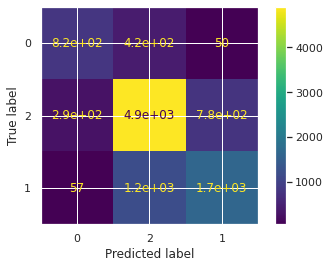

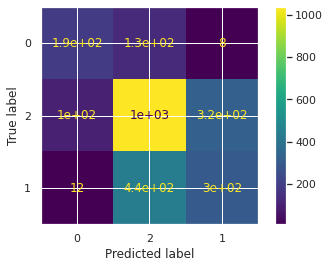

In [ ]:
context = "--- Uniform ---"
KNN_OP6 = neighbors.KNeighborsClassifier(weights= 'uniform')
KNN_OP6.fit(X_train, y_train)
yhat_train = KNN_OP6.predict(X_train)
yhat_test = KNN_OP6.predict(X_test)
Evaluate_KNN(KNN_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

<font color ='blue'>b. Create a kNN QuAM with weights parameter set to “distance”.


--- Distance ---
Accuracy on training data: 1.0
Precision on training data: [1. 1. 1.]
Recall on training data: [1. 1. 1.]
F1 score on training data: [1. 1. 1.]
Accuracy on test data: 0.609
Precision on test data: [0.6573 0.4861 0.6461]
Recall on test data: [0.5714 0.3939 0.7281]
F1 score on test data: [0.6114 0.4352 0.6846]
---------------------


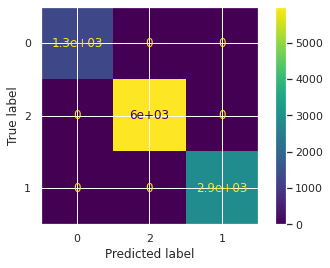

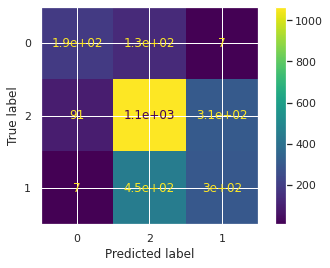

In [ ]:
context = "--- Distance ---"
KNN_OP6 = neighbors.KNeighborsClassifier(weights= 'distance')
KNN_OP6.fit(X_train, y_train)
yhat_train = KNN_OP6.predict(X_train)
yhat_test = KNN_OP6.predict(X_test)
Evaluate_KNN(KNN_OP6, X_train, y_train, yhat_train, X_test, y_test, yhat_test, context)

#kNN Evaluation:


We’ve built several QuAMs, but which is best? To determine the performance of our QuAMs we need
to evaluate them using our accuracy classification score.
In multilabel classification, our accuracy score computes the subset accuracy: the set of labels
predicted for a sample must exactly match the corresponding set of labels in y_true. As we’re
approximating, the accuracy score will return the fraction of correctly classified samples (float), or
it will return the number of correctly classified samples (int).

<font color ='blue'>3. Plot the decision boundaries for each class for the different n_neighbors and
weights. Note: For help plotting the classes’ decision boundaries see the following documentation,
https://scikit-learn.org/stable/auto_examples/neighbors/plot_classification.html


In [ ]:
import plotly.graph_objects as go

In [ ]:
KNN_OP6

NameError: ignored

In [ ]:
KNN_OP6.predict(X_test)

array([2, 0, 1, ..., 2, 1, 0])

In [ ]:
X2_train = X_train[:, :2]
X2_test = X_test[:, :2]

In [ ]:
KNN_OP6.fit(X2_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='distance')

In [ ]:
x_mins = np.min(X, axis=0)
x_maxs = np.max(X, axis=0)

In [ ]:
x0_vis_range = np.arange(x_mins[0] - 0.1, x_maxs[0] + 0.1, 0.02)
x1_vis_range = np.arange(x_mins[1] - 0.1, x_maxs[1] + 0.1, 0.02)
XX0_vis, XX1_vis = np.meshgrid(x0_vis_range, x1_vis_range)
X_vis = np.c_[XX0_vis.flatten(), XX1_vis.flatten()]

In [ ]:
yhat_vis = KNN_OP6.predict(X_vis)

In [ ]:
YYhat_vis = yhat_vis.reshape(XX0_vis.shape)

In [ ]:
yhat_test = KNN_OP6.predict(X2_test)

NameError: ignored

In [ ]:
#@title Interactive Visualizer: k { run: "auto" }

k = 58 #@param {type:"slider", min:1, max:60, step:1}
weights = 'uniform' #@param ['uniform','distance']

display(k)

KNN_OP6 = neighbors.KNeighborsClassifier(n_neighbors=k)

KNN_OP6.fit(X2_train, y_train)

yhat_vis = KNN_OP6.predict(X_vis)
YYhat_vis = yhat_vis.reshape(XX0_vis.shape)

yhat_test = KNN_OP6.predict(X2_test)

fig = go.Figure()
fig.add_trace(go.Heatmap(z=YYhat_vis, 
                        x=x0_vis_range,
                        y=x1_vis_range,
                        showscale=False))
fig.add_trace(go.Scatter(x=X2_train[:, 0],
                        y=X2_train[:, 1],
                        mode='markers',
                        marker_color=y_train, 
                        marker_line_width=1))
fig.add_trace(go.Scatter(x=X2_test[:, 0],
                        y=X2_test[:, 1],
                        mode='markers',
                        marker_color=yhat_test,
                        marker_line_width=3))
fig.update_layout(showlegend=False)
fig.update_xaxes(range=[x_mins[0] - 0.1, x_maxs[0] + 0.1],
                title=features_names[5])
fig.update_yaxes(range=[x_mins[1] - 0.1, x_maxs[1] + 0.1],
                title=features_names[6])
fig.show()

1

<font color ='blue'>4. Use the sklearn.metrics.accuracy_score method to compare the accuracy of the
several values of k, k=5, 11, and 15, and compare your original, your normalized, and your
standardized datasets.

<font color ='blue'>
Accuracy can be computed by comparing the test set values and the predicted values, e.g.,


<font color ='blue'>
Import scikit-learn metrics module for accuracy calculation

<font color ='blue'>
from sklearn import metrics

<font color ='blue'>
 Model Accuracy: how often is the classifier correct?

<font color ='blue'>
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))


In [ ]:
X_minmax = Engine_OP6_minmax[DT_feature_names].values
y_minmax = y_preprocess.fit_transform(Engine_OP6[DT_category_name])

In [ ]:
X_train_minmax, X_test_minmax, y_train_minmax, y_test_minmax = train_test_split(X, y, test_size = 0.20, random_state=42)

In [ ]:
X_standard = Engine_OP6_standard[DT_feature_names].values
y_standard = y_preprocess.fit_transform(Engine_OP6[DT_category_name])

In [ ]:
X_train_standard, X_test_standard, y_train_standard, y_test_standard = train_test_split(X, y, test_size = 0.20, random_state=42)

In [ ]:
n_neighbor = [5,11,15,20]
accuracy_score_original = []
accuracy_score_normalized = []
accuracy_score_standardized = []

#Accuracy scores for original dataset: K=5,11,15
for index, neighbor in enumerate(n_neighbor):
  KNN_OP6 = neighbors.KNeighborsClassifier(n_neighbors= neighbor)
  KNN_OP6.fit(X_train, y_train)
  yhat_train = KNN_OP6.predict(X_train)
  yhat_test = KNN_OP6.predict(X_test)

  accuracy_score_original.append(round(accuracy_score(y_test, yhat_test),4))

#Accuracy scores for normalized dataset: K=5,11,15
for index, neighbor in enumerate(n_neighbor):
  KNN_OP6_minmax = neighbors.KNeighborsClassifier(n_neighbors= neighbor)
  KNN_OP6_minmax.fit(X_train_minmax, y_train_minmax)
  yhat_train_minmax = KNN_OP6_minmax.predict(X_train_minmax)
  yhat_test_minmax = KNN_OP6_minmax.predict(X_test_minmax)

  accuracy_score_normalized.append(round(accuracy_score(y_test_minmax, yhat_test_minmax),4))

#Accuracy scores for standardized dataset: K=5,11,15
for index, neighbor in enumerate(n_neighbor):
  KNN_OP6_standard = neighbors.KNeighborsClassifier(n_neighbors= neighbor)
  KNN_OP6_standard.fit(X_train_standard, y_train_standard)
  yhat_train_standard = KNN_OP6_standard.predict(X_train_standard)
  yhat_test_standard = KNN_OP6_standard.predict(X_test_standard)

  accuracy_score_standardized.append(round(accuracy_score(y_test_standard, yhat_test_standard),4))

results_df = pd.DataFrame({'N_Neighbor': n_neighbor,
                           'Accuracy_original_dataset': accuracy_score_original,
                           'Accuracy_normalized_dataset': accuracy_score_normalized,
                           'Accuracy_standardized_dataset': accuracy_score_standardized})
results_df

,N_Neighbor,Accuracy_original_dataset,Accuracy_normalized_dataset,Accuracy_standardized_dataset
0,5,0.6003,0.6003,0.6003
1,11,0.6270,0.6270,0.6270
2,15,0.6427,0.6427,0.6427
3,20,0.6419,0.6419,0.6419


#QuAM Accuracy


<font color ='blue'>Perform a comparison of our Decision Tree QuAM vs kNN QuAM: provide a comparison table of
accuracy for your various DT QuAMS and your kNN QuAMs. This will be a tool for comparison for you
as a technician, but it will also serve as a communication tool to summarize to stakeholders what
you tried, what worked best, and why.

In [ ]:
data= [['Decision Tree',0.6674],['kNN',0.6910]]
column_names=['QuAM','Test_Accuracy']
comparision_table=pd.DataFrame(data,columns=column_names)
comparision_table

,QuAM,Test_Accuracy
0,Decision Tree,0.6674
1,kNN,0.6910


#<font color ='blue'>***End of PA3***